In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
import numpy as np

In [ ]:

# ──────────────────────────────────────────────────────────────────────────────
# 1) 데이터셋 로드 & 분할
# ──────────────────────────────────────────────────────────────────────────────
raw = torch.load('DEAM_dataset_cleaned.pt')

# dict with keys 'spectrograms', 'annotations', 'song_ids'
clean_specs = raw['spectrograms']   # Tensor list or Tensor of shape (N,1,128,60)
clean_anns  = raw['annotations']    # Tensor list or Tensor of shape (N,60,2)
clean_ids   = raw['song_ids']       # list or Tensor of shape (N,)

# make sure they're all the same length N
N = len(clean_ids)

# build unified list of dicts
data_list = []
for i in range(N):
    song_id = int(clean_ids[i])
    spec    = clean_specs[i]   # Tensor[1,128,60]
    ann     = clean_anns[i]    # Tensor[60,2]
    data_list.append({'song_id': song_id, 'spec': spec, 'ann': ann})


In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 2) Train/Val/Test split by song_id
# ──────────────────────────────────────────────────────────────────────────────
train_val_ids = {d['song_id'] for d in data_list if d['song_id'] <= 2000}
test_ids      = {d['song_id'] for d in data_list if d['song_id']  > 2000}

class DEAMDataset(Dataset):
    def __init__(self, items, id_set):
        self.samples = [d for d in items if d['song_id'] in id_set]
    def __len__(self):
        return len(self.samples)
    def __getitem__(self, idx):
        return self.samples[idx]['spec'], self.samples[idx]['ann']

train_val_ds = DEAMDataset(data_list, train_val_ids)
test_ds      = DEAMDataset(data_list, test_ids)

# within train_val, reserve 10% for validation
val_ratio = 0.1
val_size  = int(len(train_val_ds) * val_ratio)
train_size = len(train_val_ds) - val_size
train_ds, val_ds = random_split(
    train_val_ds,
    [train_size, val_size],
    generator=torch.Generator().manual_seed(42)
)

In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 3) DataLoader
# ──────────────────────────────────────────────────────────────────────────────
batch_size  = 16
num_workers = 4

train_loader = DataLoader(train_ds,   batch_size=batch_size, shuffle=True,  num_workers=num_workers)
val_loader   = DataLoader(val_ds,     batch_size=batch_size, shuffle=True, num_workers=num_workers)
test_loader  = DataLoader(test_ds,    batch_size=batch_size, shuffle=False, num_workers=num_workers)


In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 3) 모델 정의 (DetailedEmotionCNN)
# ──────────────────────────────────────────────────────────────────────────────
class DetailedEmotionCNN(nn.Module):
    def __init__(self, dropout_cfg=(0.2,0.2,0.3,0.3)):
        super().__init__()
        d1, d2, d3, d4 = dropout_cfg

        self.block1 = nn.Sequential(
            nn.Conv2d(1, 16, 3, padding=1), nn.BatchNorm2d(16), nn.ReLU(inplace=True),
            nn.Conv2d(16,16,3,padding=1),   nn.BatchNorm2d(16), nn.ReLU(inplace=True),
            nn.Dropout(d1),                 nn.MaxPool2d((2,1),(2,1))
        )
        self.block2 = nn.Sequential(
            nn.Conv2d(16,32,3,padding=1),  nn.BatchNorm2d(32), nn.ReLU(inplace=True),
            nn.Conv2d(32,32,3,padding=1),  nn.BatchNorm2d(32), nn.ReLU(inplace=True),
            nn.Dropout(d2),                nn.MaxPool2d((2,1),(2,1))
        )
        self.block3 = nn.Sequential(
            nn.Conv2d(32,64,3,padding=1),  nn.BatchNorm2d(64), nn.ReLU(inplace=True),
            nn.Conv2d(64,64,3,padding=1),  nn.BatchNorm2d(64), nn.ReLU(inplace=True),
            nn.Dropout(d3),                nn.MaxPool2d((2,1),(2,1))
        )
        self.block4 = nn.Sequential(
            nn.Conv2d(64,128,3,padding=1), nn.BatchNorm2d(128), nn.ReLU(inplace=True),
            nn.Conv2d(128,128,3,padding=1),nn.BatchNorm2d(128), nn.ReLU(inplace=True),
            nn.Dropout(d4),                nn.MaxPool2d((2,1),(2,1)),
            nn.Conv2d(128,128,3,padding=1),nn.BatchNorm2d(128), nn.ReLU(inplace=True),
            nn.MaxPool2d((8,1),(8,1))
        )

        self.conv_out = nn.Conv2d(128, 2, kernel_size=1)

    def forward(self, x):
        # x: [B,1,128,60]
        x = self.block1(x)   # → [B,16,64,60]
        x = self.block2(x)   # → [B,32,32,60]
        x = self.block3(x)   # → [B,64,16,60]
        x = self.block4(x)   # → [B,128, 1,60]
        x = self.conv_out(x) # → [B,  2, 1,60]
        x = x.squeeze(2)     # → [B,2,60]
        x = x.permute(0,2,1) # → [B,60,2]
        return x


##음수 커버 버젼

In [ ]:

class DetailedEmotionCNN(nn.Module):
    def __init__(self, dropout_cfg=(0.2, 0.2, 0.3, 0.3), negative_slope=0.5):
        super().__init__()
        d1, d2, d3, d4 = dropout_cfg
        nl = negative_slope

        # leaky ReLU 대신 PReLU 쓰고 싶으면 nn.PReLU() 로 바꿀 수 있습니다.
        self.block1 = nn.Sequential(
            nn.Conv2d(1, 16, kernel_size=3, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(negative_slope=nl, inplace=True),

            nn.Conv2d(16, 16, kernel_size=3, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(negative_slope=nl, inplace=True),

            nn.Dropout(d1),
            nn.MaxPool2d((2, 1), stride=(2, 1)),
        )

        self.block2 = nn.Sequential(
            nn.Conv2d(16, 32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(negative_slope=nl, inplace=True),

            nn.Conv2d(32, 32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(negative_slope=nl, inplace=True),

            nn.Dropout(d2),
            nn.MaxPool2d((2, 1), stride=(2, 1)),
        )

        self.block3 = nn.Sequential(
            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(negative_slope=nl, inplace=True),

            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(negative_slope=nl, inplace=True),

            nn.Dropout(d3),
            nn.MaxPool2d((2, 1), stride=(2, 1)),
        )

        self.block4 = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(negative_slope=nl, inplace=True),

            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(negative_slope=nl, inplace=True),

            nn.Dropout(d4),
            nn.MaxPool2d((2, 1), stride=(2, 1)),

            # 추가 conv + pool
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(negative_slope=nl, inplace=True),

            nn.MaxPool2d((8, 1), stride=(8, 1)),
        )

        # 최종 출력은 2채널(valence, arousal)
        self.conv_out = nn.Conv2d(128, 2, kernel_size=1)

    def forward(self, x):
        # x: [B, 1, 128, T]
        x = self.block1(x)     # → [B, 16, 64, T]
        x = self.block2(x)     # → [B, 32, 32, T]
        x = self.block3(x)     # → [B, 64, 16, T]
        x = self.block4(x)     # → [B,128, 1, T]
        x = self.conv_out(x)   # → [B,  2, 1, T]
        x = x.squeeze(2)       # → [B, 2, T]
        x = x.permute(0, 2, 1) # → [B, T, 2]
        # tanh 활성함수로 출력값을 −1∼+1 범위로 제한
        return torch.tanh(x)

##학습 설정

In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 4) 학습 설정
# ──────────────────────────────────────────────────────────────────────────────
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = DetailedEmotionCNN().to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-3, weight_decay=1e-5)
criterion = nn.MSELoss()
scheduler = optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, mode='min', factor=0.5, patience=7, verbose=True
)

num_epochs = 50
best_val_loss = float('inf')
early_stop_patience = 7
early_stop_counter = 0


/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


In [ ]:
 # ──────────────────────────────────────────────────────────────────────────────
# 5) 학습 루프 (Train / Validation / Scheduler / Checkpoint)
# ──────────────────────────────────────────────────────────────────────────────
for epoch in range(1, num_epochs+1):
    # --- TRAIN ---
    model.train()
    running_train_loss = 0.0
    for spec, ann in train_loader:
        spec = spec.to(device)   # [B,1,128,60]
        ann  = ann.to(device)    # [B,60,2]
        optimizer.zero_grad()
        pred = model(spec)       # [B,60,2]
        loss = criterion(pred, ann)
        loss.backward()
        optimizer.step()
        running_train_loss += loss.item() * spec.size(0)
    train_loss = running_train_loss / len(train_loader.dataset)

    # --- VALIDATION ---
    model.eval()
    running_val_loss = 0.0
    with torch.no_grad():
        for spec, ann in val_loader:
            spec = spec.to(device)
            ann  = ann.to(device)
            pred = model(spec)
            running_val_loss += criterion(pred, ann).item() * spec.size(0)
    val_loss = running_val_loss / len(val_loader.dataset)

    # --- Scheduler & Checkpoint & EarlyStopping ---
    scheduler.step(val_loss)
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(model.state_dict(), 'best_emotion_cnn.pt')
        early_stop_counter = 0
        best_epoch = epoch
    else:
        early_stop_counter += 1

    # --- 로그 ---
    lr = optimizer.param_groups[0]['lr']
    print(f"Epoch {epoch:02d} | Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f} | LR: {lr:.2e}")

    if early_stop_counter >= early_stop_patience:
        print(f"Early stopping at epoch {epoch}. (Best Val Loss: {best_val_loss:.4f} @ epoch {best_epoch})")
        break

print(f"Training complete. Best Val Loss: {best_val_loss:.4f} (epoch {best_epoch})")

Epoch 01 | Train Loss: 0.0705 | Val Loss: 0.0480 | LR: 1.00e-03
Epoch 02 | Train Loss: 0.0516 | Val Loss: 0.0629 | LR: 1.00e-03
Epoch 03 | Train Loss: 0.0453 | Val Loss: 0.0594 | LR: 1.00e-03
Epoch 04 | Train Loss: 0.0485 | Val Loss: 0.0663 | LR: 1.00e-03
Epoch 05 | Train Loss: 0.0456 | Val Loss: 0.0523 | LR: 1.00e-03
Epoch 06 | Train Loss: 0.0463 | Val Loss: 0.0430 | LR: 1.00e-03
Epoch 07 | Train Loss: 0.0464 | Val Loss: 0.0604 | LR: 1.00e-03
Epoch 08 | Train Loss: 0.0453 | Val Loss: 0.0446 | LR: 1.00e-03
Epoch 09 | Train Loss: 0.0456 | Val Loss: 0.0538 | LR: 1.00e-03
Epoch 10 | Train Loss: 0.0454 | Val Loss: 0.0506 | LR: 1.00e-03
Epoch 11 | Train Loss: 0.0454 | Val Loss: 0.0511 | LR: 1.00e-03
Epoch 12 | Train Loss: 0.0441 | Val Loss: 0.0480 | LR: 1.00e-03
Epoch 13 | Train Loss: 0.0435 | Val Loss: 0.0512 | LR: 1.00e-03
Early stopping at epoch 13. (Best Val Loss: 0.0430 @ epoch 6)
Training complete. Best Val Loss: 0.0430 (epoch 6)


In [ ]:
def collate_fn(batch):
    specs = torch.stack([s for s,_ in batch], dim=0)
    anns  = torch.stack([a for _,a in batch], dim=0)
    return specs, anns

test_loader = DataLoader(test_ds, batch_size=1, shuffle=False, num_workers=4)


In [ ]:
test_loss = 0.0
with torch.no_grad():
    for spec, ann in test_loader:
        spec, ann = spec.to(device), ann.to(device)
        pred = model(spec)            # spec: [1,1,128,T], pred: [1,T,2]
        test_loss += criterion(pred, ann).item()  # ann: [1,T,2]

# test_loader.dataset 은 sample 수
test_loss /= len(test_loader.dataset)
print(f"Test MSE Loss: {test_loss:.4f}")

Test MSE Loss: 0.0922


In [ ]:
total_params = sum(p.numel() for p in model.parameters())
trainable   = sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f"Total: {total_params:,}개, Trainable: {trainable:,}개")

Total: 442,290개, Trainable: 442,290개


In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import r2_score

In [ ]:
# 4) 학습 루프 (+지표 모니터링)
for epoch in range(1, num_epochs+1):
    # TRAIN
    model.train()
    running_train_loss = 0.0
    for spec, ann in train_loader:
        spec, ann = spec.to(device), ann.to(device)
        optimizer.zero_grad()
        pred = model(spec)
        loss = criterion(pred, ann)
        loss.backward()
        optimizer.step()
        running_train_loss += loss.item() * spec.size(0)
    train_loss = running_train_loss / len(train_loader.dataset)

    # VALIDATION + 지표 수집
    model.eval()
    running_val_loss = 0.0
    all_preds, all_trues = [], []
    with torch.no_grad():
        for spec, ann in val_loader:
            spec, ann = spec.to(device), ann.to(device)
            pred = model(spec)
            running_val_loss += criterion(pred, ann).item() * spec.size(0)
            all_preds.append(pred.cpu().numpy().reshape(-1,2))
            all_trues.append(ann.cpu().numpy().reshape(-1,2))

    val_loss = running_val_loss / len(val_loader.dataset)
    preds = np.vstack(all_preds)
    trues = np.vstack(all_trues)

    # --- Regression Metrics ---
    mse     = np.mean((preds - trues)**2)
    mae     = np.mean(np.abs(preds - trues))
    r_val   = np.corrcoef(trues[:,0], preds[:,0])[0,1]
    r_aro   = np.corrcoef(trues[:,1], preds[:,1])[0,1]
    # --- 추가된 R2 계산 ---
    r2_val  = r2_score(trues[:,0], preds[:,0])
    r2_aro  = r2_score(trues[:,1], preds[:,1])

    # Scheduler & Checkpoint & EarlyStopping
    scheduler.step(val_loss)
    if val_loss < best_val_loss:
        best_val_loss      = val_loss
        best_epoch         = epoch
        early_stop_counter = 0
        torch.save(model.state_dict(), 'best_emotion_cnn.pt')
    else:
        early_stop_counter += 1

    lr = optimizer.param_groups[0]['lr']

    # 로그 출력 (R2 항 추가)
    print(f"Epoch {epoch:02d} | "
          f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f} | LR: {lr:.2e}")
    print(f"  → MSE: {mse:.4f}, MAE: {mae:.4f}, "
          f"Corr(V): {r_val:.4f}, Corr(A): {r_aro:.4f}, "
          f"R2(V): {r2_val:.4f}, R2(A): {r2_aro:.4f}")

    if early_stop_counter >= early_stop_patience:
        print(f"Early stopping at epoch {epoch}. "
              f"(Best Val Loss: {best_val_loss:.4f} @ epoch {best_epoch})")
        break

print(f"Training complete. Best Val Loss: {best_val_loss:.4f} (epoch {best_epoch})")

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 01 | Train Loss: 0.0732 | Val Loss: 0.0725 | LR: 1.00e-03
  → MSE: 0.0725, MAE: 0.2130, Corr(V): 0.3777, Corr(A): 0.7302, R2(V): -0.6005, R2(A): 0.4174


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 02 | Train Loss: 0.0552 | Val Loss: 0.0468 | LR: 1.00e-03
  → MSE: 0.0468, MAE: 0.1694, Corr(V): 0.4018, Corr(A): 0.7701, R2(V): 0.1291, R2(A): 0.5012


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 03 | Train Loss: 0.0496 | Val Loss: 0.0558 | LR: 1.00e-03
  → MSE: 0.0558, MAE: 0.1819, Corr(V): 0.4220, Corr(A): 0.7580, R2(V): 0.0347, R2(A): 0.3510


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 04 | Train Loss: 0.0500 | Val Loss: 0.0491 | LR: 1.00e-03
  → MSE: 0.0491, MAE: 0.1743, Corr(V): 0.4046, Corr(A): 0.7454, R2(V): 0.0602, R2(A): 0.4966


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 05 | Train Loss: 0.0502 | Val Loss: 0.0492 | LR: 1.00e-03
  → MSE: 0.0492, MAE: 0.1720, Corr(V): 0.4166, Corr(A): 0.7632, R2(V): 0.0143, R2(A): 0.5284


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 06 | Train Loss: 0.0483 | Val Loss: 0.0445 | LR: 1.00e-03
  → MSE: 0.0445, MAE: 0.1654, Corr(V): 0.4890, Corr(A): 0.7796, R2(V): 0.1354, R2(A): 0.5551


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 07 | Train Loss: 0.0486 | Val Loss: 0.0625 | LR: 1.00e-03
  → MSE: 0.0625, MAE: 0.2028, Corr(V): 0.3656, Corr(A): 0.7487, R2(V): -0.0224, R2(A): 0.2300


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 08 | Train Loss: 0.0468 | Val Loss: 0.0491 | LR: 1.00e-03
  → MSE: 0.0491, MAE: 0.1740, Corr(V): 0.4202, Corr(A): 0.7498, R2(V): 0.1473, R2(A): 0.4333


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 09 | Train Loss: 0.0445 | Val Loss: 0.0500 | LR: 1.00e-03
  → MSE: 0.0500, MAE: 0.1735, Corr(V): 0.4677, Corr(A): 0.7797, R2(V): -0.0237, R2(A): 0.5385


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 10 | Train Loss: 0.0467 | Val Loss: 0.0478 | LR: 1.00e-03
  → MSE: 0.0478, MAE: 0.1715, Corr(V): 0.4402, Corr(A): 0.7640, R2(V): 0.1932, R2(A): 0.4290


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 11 | Train Loss: 0.0426 | Val Loss: 0.0431 | LR: 1.00e-03
  → MSE: 0.0431, MAE: 0.1628, Corr(V): 0.4893, Corr(A): 0.7766, R2(V): 0.2204, R2(A): 0.5248


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 12 | Train Loss: 0.0444 | Val Loss: 0.0444 | LR: 1.00e-03
  → MSE: 0.0444, MAE: 0.1655, Corr(V): 0.4963, Corr(A): 0.7604, R2(V): 0.2016, R2(A): 0.5077


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 13 | Train Loss: 0.0434 | Val Loss: 0.0530 | LR: 1.00e-03
  → MSE: 0.0530, MAE: 0.1763, Corr(V): 0.4744, Corr(A): 0.7775, R2(V): 0.1226, R2(A): 0.3560


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 14 | Train Loss: 0.0450 | Val Loss: 0.0423 | LR: 1.00e-03
  → MSE: 0.0423, MAE: 0.1625, Corr(V): 0.4983, Corr(A): 0.7777, R2(V): 0.2171, R2(A): 0.5472


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 15 | Train Loss: 0.0440 | Val Loss: 0.0584 | LR: 1.00e-03
  → MSE: 0.0584, MAE: 0.1860, Corr(V): 0.4937, Corr(A): 0.7592, R2(V): -0.2618, R2(A): 0.5106


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 16 | Train Loss: 0.0433 | Val Loss: 0.0474 | LR: 1.00e-03
  → MSE: 0.0474, MAE: 0.1797, Corr(V): 0.4920, Corr(A): 0.7920, R2(V): 0.1671, R2(A): 0.4589


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 17 | Train Loss: 0.0437 | Val Loss: 0.0548 | LR: 1.00e-03
  → MSE: 0.0548, MAE: 0.1790, Corr(V): 0.5029, Corr(A): 0.7568, R2(V): 0.1005, R2(A): 0.3262


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 18 | Train Loss: 0.0401 | Val Loss: 0.0456 | LR: 1.00e-03
  → MSE: 0.0456, MAE: 0.1746, Corr(V): 0.5094, Corr(A): 0.7875, R2(V): 0.1561, R2(A): 0.5105


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 19 | Train Loss: 0.0426 | Val Loss: 0.0449 | LR: 1.00e-03
  → MSE: 0.0449, MAE: 0.1709, Corr(V): 0.4864, Corr(A): 0.7845, R2(V): 0.2132, R2(A): 0.4863


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 20 | Train Loss: 0.0406 | Val Loss: 0.0460 | LR: 1.00e-03
  → MSE: 0.0460, MAE: 0.1647, Corr(V): 0.5098, Corr(A): 0.7862, R2(V): 0.0683, R2(A): 0.5672


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 21 | Train Loss: 0.0412 | Val Loss: 0.0530 | LR: 1.00e-03
  → MSE: 0.0530, MAE: 0.1749, Corr(V): 0.4715, Corr(A): 0.7746, R2(V): -0.0405, R2(A): 0.4759
Early stopping at epoch 21. (Best Val Loss: 0.0423 @ epoch 14)
Training complete. Best Val Loss: 0.0423 (epoch 14)


In [ ]:
# Concordance Correlation Coefficient 함수 정의
def concordance_correlation_coefficient(y_true: np.ndarray, y_pred: np.ndarray) -> float:
    """
    CCC = 2 * cov(y_true, y_pred)
          / (var(y_true) + var(y_pred) + (mean(y_true) - mean(y_pred))**2)
    """
    true_mean = np.mean(y_true)
    pred_mean = np.mean(y_pred)
    covariance = np.mean((y_true - true_mean) * (y_pred - pred_mean))
    true_var = np.var(y_true)
    pred_var = np.var(y_pred)
    # 작은 값 더해 분모 0 방지
    return 2 * covariance / (true_var + pred_var + (true_mean - pred_mean)**2 + 1e-8)


for epoch in range(1, num_epochs + 1):
    # --- TRAIN ---
    model.train()
    running_train_loss = 0.0
    for spec, ann in train_loader:
        spec, ann = spec.to(device), ann.to(device)
        optimizer.zero_grad()
        pred = model(spec)
        loss = criterion(pred, ann)
        loss.backward()
        optimizer.step()
        running_train_loss += loss.item() * spec.size(0)
    train_loss = running_train_loss / len(train_loader.dataset)

    # --- VALIDATION 및 지표 수집 ---
    model.eval()
    running_val_loss = 0.0
    all_preds, all_trues = [], []
    with torch.no_grad():
        for spec, ann in val_loader:
            spec, ann = spec.to(device), ann.to(device)
            pred = model(spec)
            running_val_loss += criterion(pred, ann).item() * spec.size(0)
            all_preds.append(pred.cpu().numpy().reshape(-1, 2))
            all_trues.append(ann.cpu().numpy().reshape(-1, 2))

    val_loss = running_val_loss / len(val_loader.dataset)
    preds    = np.vstack(all_preds)
    trues    = np.vstack(all_trues)

    # --- 회귀 지표 계산 ---
    mse     = np.mean((preds - trues) ** 2)
    mae     = np.mean(np.abs(preds - trues))
    r_val   = np.corrcoef(trues[:, 0], preds[:, 0])[0, 1]
    r_aro   = np.corrcoef(trues[:, 1], preds[:, 1])[0, 1]
    r2_val  = r2_score(trues[:, 0], preds[:, 0])
    r2_aro  = r2_score(trues[:, 1], preds[:, 1])
    ccc_val = concordance_correlation_coefficient(trues[:, 0], preds[:, 0])
    ccc_aro = concordance_correlation_coefficient(trues[:, 1], preds[:, 1])

    # 스케줄러, 체크포인트, Early Stopping
    scheduler.step(val_loss)
    if val_loss < best_val_loss:
        best_val_loss      = val_loss
        best_epoch         = epoch
        early_stop_counter = 0
        torch.save(model.state_dict(), 'best_emotion_cnn.pt')
    else:
        early_stop_counter += 1

    lr = optimizer.param_groups[0]['lr']

    # 지표 출력
    print(f"Epoch {epoch:02d} | "
          f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f} | LR: {lr:.2e}")
    print(f"  → MSE: {mse:.4f}, MAE: {mae:.4f}, "
          f"Corr(V): {r_val:.4f}, Corr(A): {r_aro:.4f}, "
          f"R2(V): {r2_val:.4f}, R2(A): {r2_aro:.4f}, "
          f"CCC(V): {ccc_val:.4f}, CCC(A): {ccc_aro:.4f}")

    if early_stop_counter >= early_stop_patience:
        print(f"Early stopping at epoch {epoch}. "
              f"(Best Val Loss: {best_val_loss:.4f} @ epoch {best_epoch})")
        break

print(f"Training complete. Best Val Loss: {best_val_loss:.4f} (epoch {best_epoch})")


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 01 | Train Loss: 0.0686 | Val Loss: 0.0493 | LR: 1.00e-03
  → MSE: 0.0493, MAE: 0.1755, Corr(V): 0.3804, Corr(A): 0.7291, R2(V): 0.0925, R2(A): 0.4688, CCC(V): 0.2236, CCC(A): 0.5687


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 02 | Train Loss: 0.0547 | Val Loss: 0.0616 | LR: 1.00e-03
  → MSE: 0.0616, MAE: 0.1900, Corr(V): 0.3680, Corr(A): 0.7404, R2(V): -0.2608, R2(A): 0.4297, CCC(V): 0.1548, CCC(A): 0.5928


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 03 | Train Loss: 0.0510 | Val Loss: 0.0475 | LR: 1.00e-03
  → MSE: 0.0475, MAE: 0.1728, Corr(V): 0.4220, Corr(A): 0.7221, R2(V): 0.1379, R2(A): 0.4793, CCC(V): 0.1976, CCC(A): 0.6663


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 04 | Train Loss: 0.0537 | Val Loss: 0.0483 | LR: 1.00e-03
  → MSE: 0.0483, MAE: 0.1809, Corr(V): 0.3592, Corr(A): 0.7458, R2(V): 0.0571, R2(A): 0.5184, CCC(V): 0.1398, CCC(A): 0.6468


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 05 | Train Loss: 0.0490 | Val Loss: 0.0499 | LR: 1.00e-03
  → MSE: 0.0499, MAE: 0.1838, Corr(V): 0.4341, Corr(A): 0.7696, R2(V): 0.1254, R2(A): 0.4290, CCC(V): 0.2093, CCC(A): 0.5748


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 06 | Train Loss: 0.0483 | Val Loss: 0.0524 | LR: 1.00e-03
  → MSE: 0.0524, MAE: 0.1823, Corr(V): 0.2692, Corr(A): 0.7070, R2(V): 0.0313, R2(A): 0.4384, CCC(V): 0.0688, CCC(A): 0.5412


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 07 | Train Loss: 0.0492 | Val Loss: 0.0468 | LR: 1.00e-03
  → MSE: 0.0468, MAE: 0.1651, Corr(V): 0.3961, Corr(A): 0.7421, R2(V): 0.0928, R2(A): 0.5301, CCC(V): 0.2955, CCC(A): 0.6682


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 08 | Train Loss: 0.0471 | Val Loss: 0.0441 | LR: 1.00e-03
  → MSE: 0.0441, MAE: 0.1630, Corr(V): 0.4459, Corr(A): 0.7555, R2(V): 0.1472, R2(A): 0.5551, CCC(V): 0.2707, CCC(A): 0.6821


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 09 | Train Loss: 0.0458 | Val Loss: 0.0458 | LR: 1.00e-03
  → MSE: 0.0458, MAE: 0.1652, Corr(V): 0.4969, Corr(A): 0.7622, R2(V): 0.1314, R2(A): 0.5250, CCC(V): 0.2566, CCC(A): 0.6538


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 10 | Train Loss: 0.0469 | Val Loss: 0.0447 | LR: 1.00e-03
  → MSE: 0.0447, MAE: 0.1688, Corr(V): 0.4709, Corr(A): 0.7664, R2(V): 0.1705, R2(A): 0.5230, CCC(V): 0.2682, CCC(A): 0.6486


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 11 | Train Loss: 0.0446 | Val Loss: 0.0444 | LR: 1.00e-03
  → MSE: 0.0444, MAE: 0.1716, Corr(V): 0.4793, Corr(A): 0.7800, R2(V): 0.1278, R2(A): 0.5625, CCC(V): 0.2344, CCC(A): 0.6721


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 12 | Train Loss: 0.0478 | Val Loss: 0.0474 | LR: 1.00e-03
  → MSE: 0.0474, MAE: 0.1651, Corr(V): 0.4351, Corr(A): 0.7824, R2(V): -0.0183, R2(A): 0.5968, CCC(V): 0.3090, CCC(A): 0.7200


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 13 | Train Loss: 0.0447 | Val Loss: 0.0453 | LR: 1.00e-03
  → MSE: 0.0453, MAE: 0.1648, Corr(V): 0.4646, Corr(A): 0.7791, R2(V): 0.1877, R2(A): 0.4941, CCC(V): 0.3289, CCC(A): 0.6137


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 14 | Train Loss: 0.0440 | Val Loss: 0.0456 | LR: 1.00e-03
  → MSE: 0.0456, MAE: 0.1758, Corr(V): 0.5033, Corr(A): 0.7899, R2(V): 0.1274, R2(A): 0.5323, CCC(V): 0.2787, CCC(A): 0.6488


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 15 | Train Loss: 0.0440 | Val Loss: 0.0393 | LR: 1.00e-03
  → MSE: 0.0393, MAE: 0.1569, Corr(V): 0.5185, Corr(A): 0.8055, R2(V): 0.2522, R2(A): 0.5939, CCC(V): 0.3551, CCC(A): 0.6938


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 16 | Train Loss: 0.0423 | Val Loss: 0.0418 | LR: 1.00e-03
  → MSE: 0.0418, MAE: 0.1614, Corr(V): 0.4918, Corr(A): 0.7885, R2(V): 0.2084, R2(A): 0.5657, CCC(V): 0.2856, CCC(A): 0.6716


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 17 | Train Loss: 0.0430 | Val Loss: 0.0432 | LR: 1.00e-03
  → MSE: 0.0432, MAE: 0.1688, Corr(V): 0.5038, Corr(A): 0.7788, R2(V): 0.2231, R2(A): 0.5208, CCC(V): 0.3112, CCC(A): 0.6454


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 18 | Train Loss: 0.0423 | Val Loss: 0.0422 | LR: 1.00e-03
  → MSE: 0.0422, MAE: 0.1640, Corr(V): 0.4848, Corr(A): 0.7687, R2(V): 0.2068, R2(A): 0.5577, CCC(V): 0.2864, CCC(A): 0.6782


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 19 | Train Loss: 0.0421 | Val Loss: 0.0410 | LR: 1.00e-03
  → MSE: 0.0410, MAE: 0.1566, Corr(V): 0.4875, Corr(A): 0.7881, R2(V): 0.1886, R2(A): 0.5999, CCC(V): 0.4076, CCC(A): 0.7293


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 20 | Train Loss: 0.0430 | Val Loss: 0.0529 | LR: 1.00e-03
  → MSE: 0.0529, MAE: 0.1724, Corr(V): 0.4600, Corr(A): 0.7653, R2(V): -0.0526, R2(A): 0.4882, CCC(V): 0.3148, CCC(A): 0.6879


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 21 | Train Loss: 0.0418 | Val Loss: 0.0450 | LR: 1.00e-03
  → MSE: 0.0450, MAE: 0.1736, Corr(V): 0.5348, Corr(A): 0.8017, R2(V): 0.2480, R2(A): 0.4581, CCC(V): 0.3316, CCC(A): 0.6173


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Epoch 22 | Train Loss: 0.0445 | Val Loss: 0.0544 | LR: 1.00e-03
  → MSE: 0.0544, MAE: 0.1927, Corr(V): 0.5231, Corr(A): 0.7685, R2(V): -0.1155, R2(A): 0.4999, CCC(V): 0.2011, CCC(A): 0.5948
Early stopping at epoch 22. (Best Val Loss: 0.0393 @ epoch 15)
Training complete. Best Val Loss: 0.0393 (epoch 15)


## CNN MK2


Using device: cuda
Model has 442,290 trainable parameters.


/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch 01 | Train Loss: 0.1471 | Val Loss: 0.0802 | LR: 1.00e-04
  → Val Metrics: MAE: 0.2231, R2(V/A): -0.9483/0.3773, CCC(V/A): 0.1154/0.6091


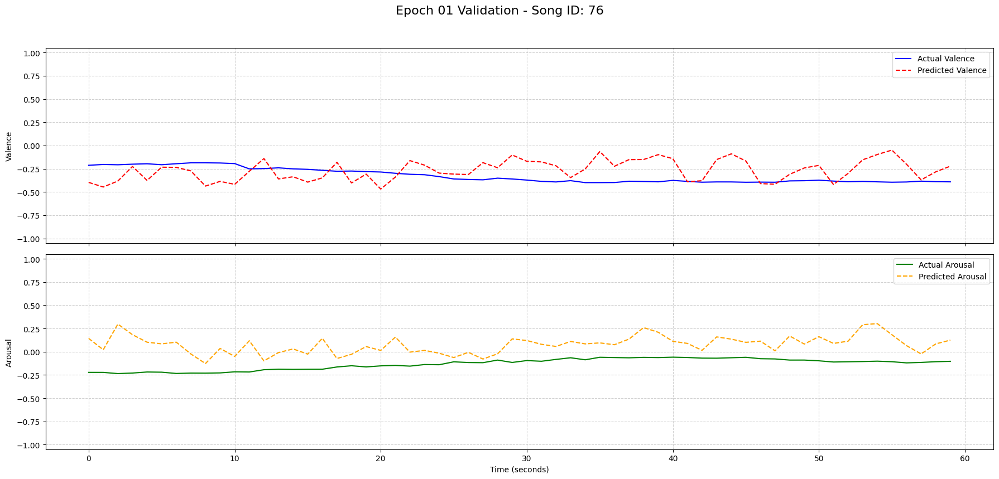

  → Validation loss decreased (inf --> 0.0802). Saving model...
Epoch 02 | Train Loss: 0.0645 | Val Loss: 0.0631 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1979, R2(V/A): -0.0878/0.1934, CCC(V/A): 0.2035/0.4839


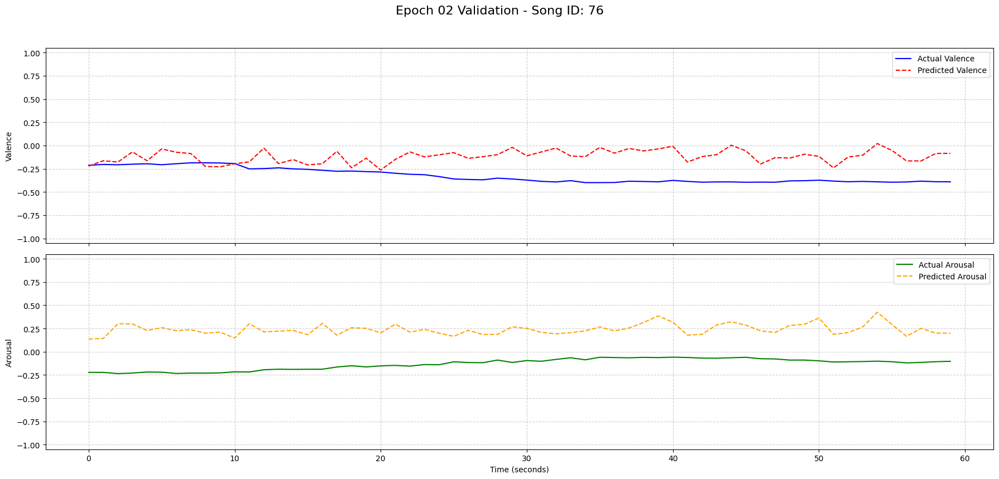

  → Validation loss decreased (0.0802 --> 0.0631). Saving model...
Epoch 03 | Train Loss: 0.0566 | Val Loss: 0.0637 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1990, R2(V/A): 0.0310/0.0962, CCC(V/A): 0.1675/0.4467


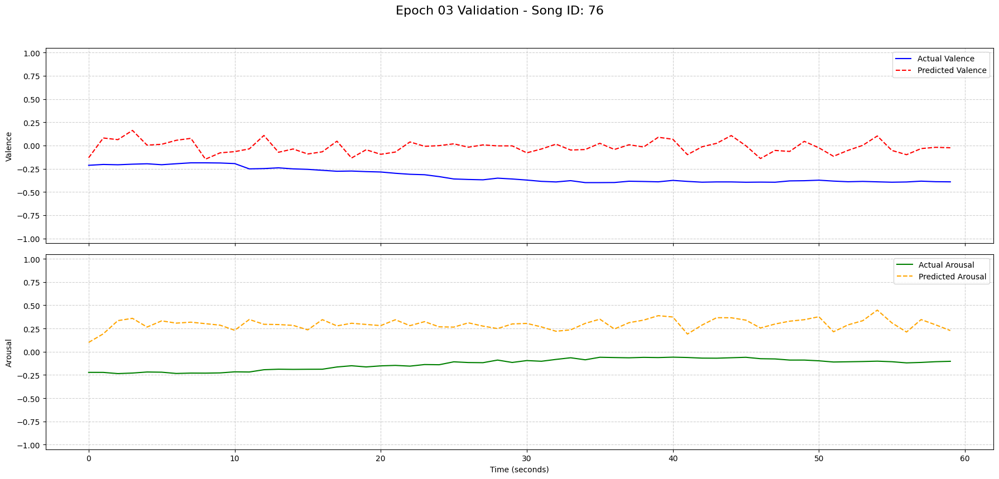

  → EarlyStopping counter: 1 out of 10
Epoch 04 | Train Loss: 0.0522 | Val Loss: 0.0534 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1818, R2(V/A): -0.0087/0.3817, CCC(V/A): 0.2175/0.5948


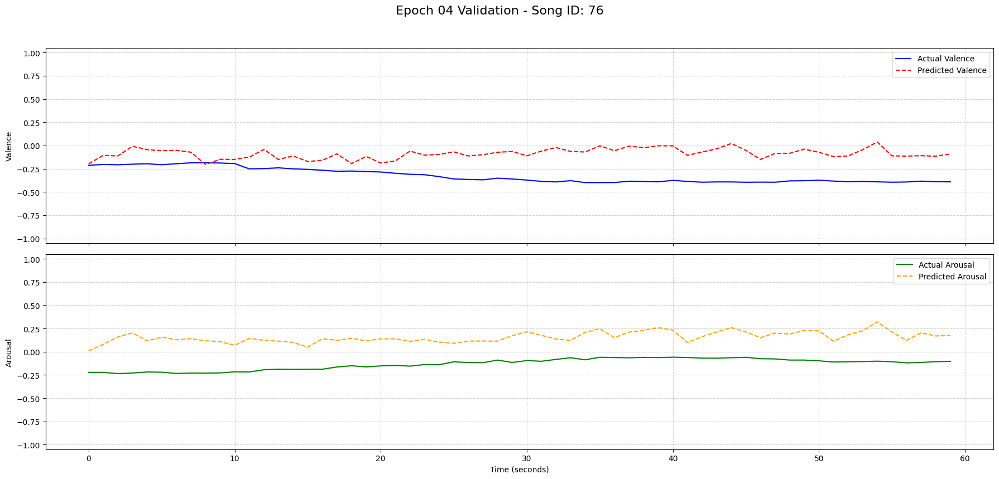

  → Validation loss decreased (0.0631 --> 0.0534). Saving model...
Epoch 05 | Train Loss: 0.0502 | Val Loss: 0.0531 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1817, R2(V/A): -0.0588/0.4240, CCC(V/A): 0.2060/0.6070


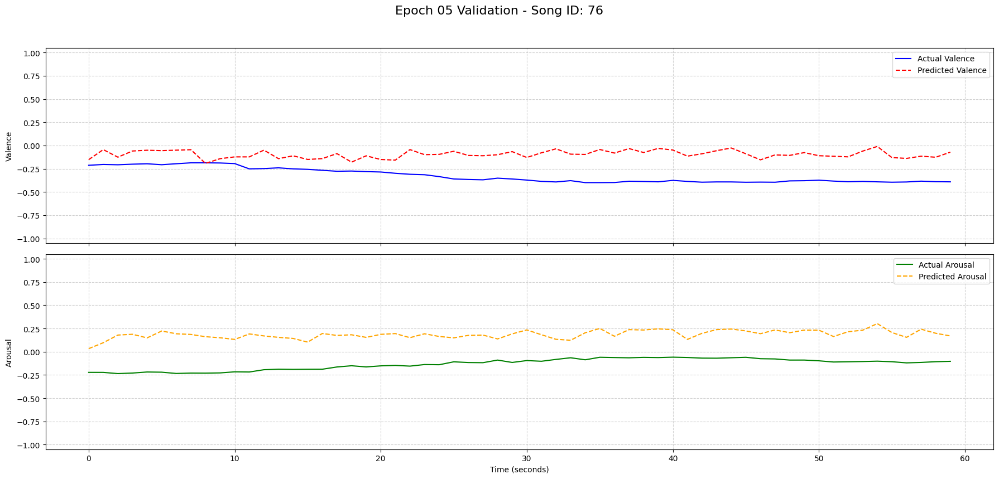

  → Validation loss decreased (0.0534 --> 0.0531). Saving model...
Epoch 06 | Train Loss: 0.0483 | Val Loss: 0.0508 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1771, R2(V/A): -0.0720/0.4910, CCC(V/A): 0.2808/0.6812


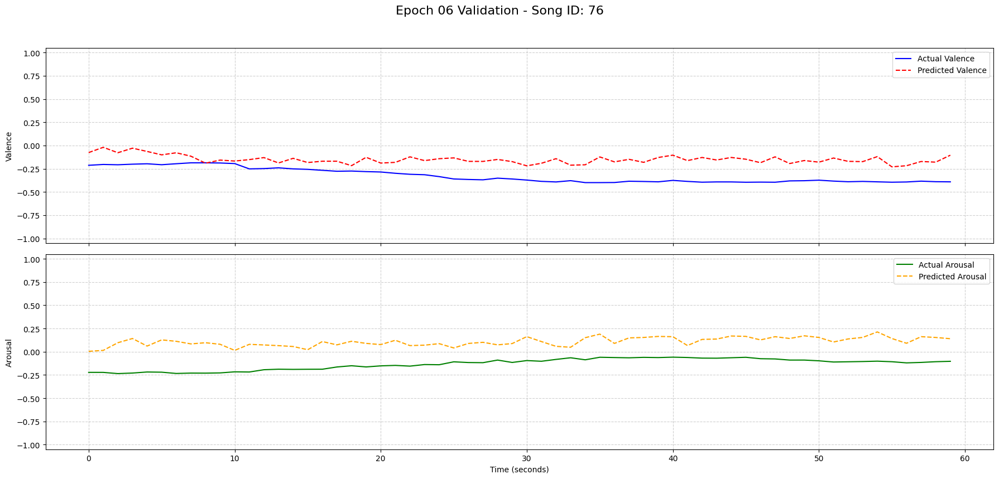

  → Validation loss decreased (0.0531 --> 0.0508). Saving model...
Epoch 07 | Train Loss: 0.0469 | Val Loss: 0.0487 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1742, R2(V/A): 0.0437/0.4619, CCC(V/A): 0.2504/0.6108


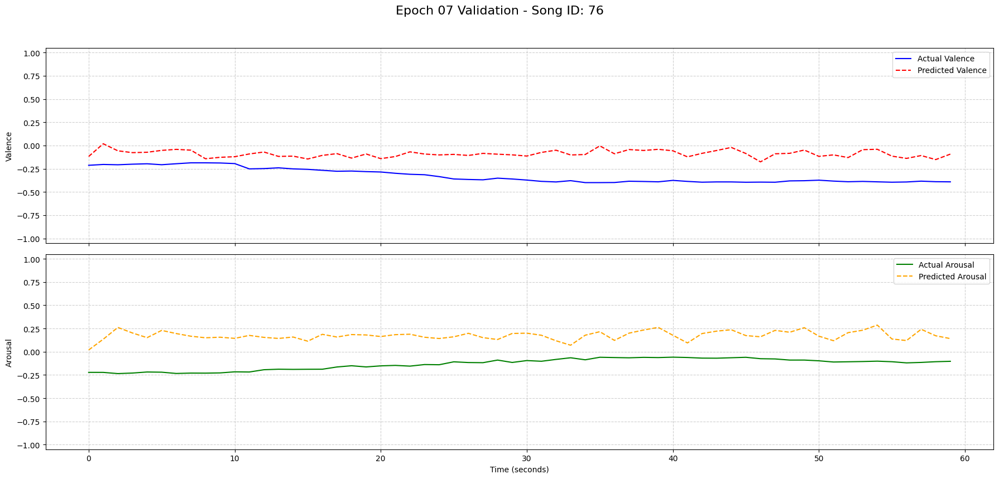

  → Validation loss decreased (0.0508 --> 0.0487). Saving model...
Epoch 08 | Train Loss: 0.0456 | Val Loss: 0.0506 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1757, R2(V/A): 0.1331/0.3495, CCC(V/A): 0.2924/0.5386


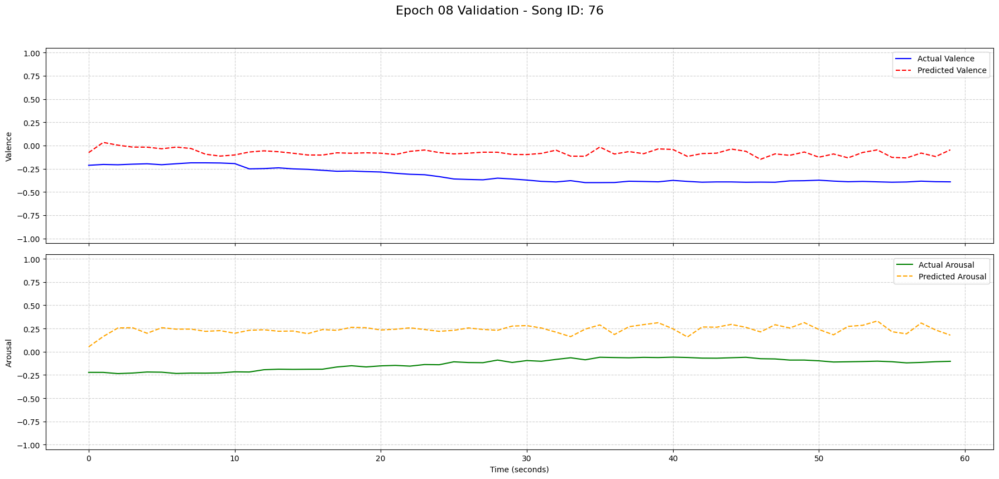

  → EarlyStopping counter: 1 out of 10
Epoch 09 | Train Loss: 0.0442 | Val Loss: 0.0457 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1688, R2(V/A): 0.1218/0.4811, CCC(V/A): 0.2650/0.6166


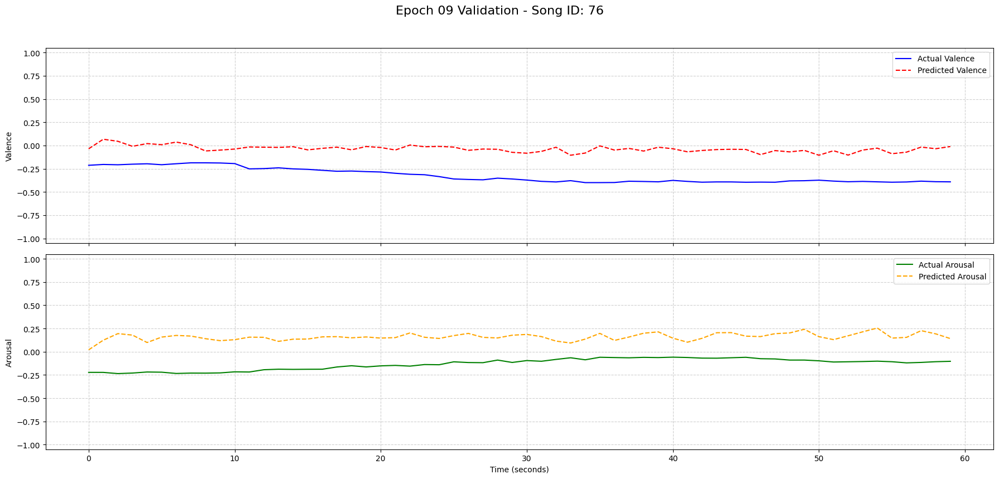

  → Validation loss decreased (0.0487 --> 0.0457). Saving model...
Epoch 10 | Train Loss: 0.0441 | Val Loss: 0.0498 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1793, R2(V/A): -0.0159/0.4746, CCC(V/A): 0.2606/0.5862


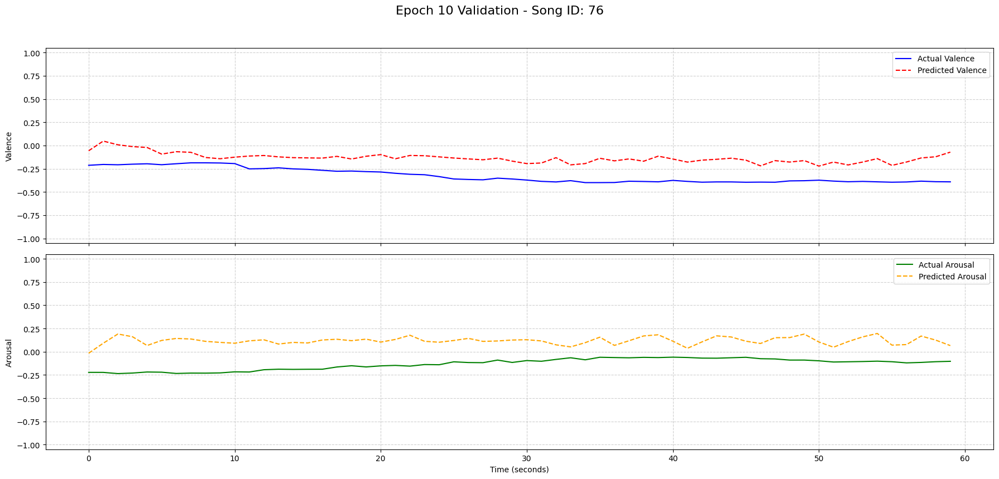

  → EarlyStopping counter: 1 out of 10
Epoch 11 | Train Loss: 0.0431 | Val Loss: 0.0474 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1692, R2(V/A): 0.0043/0.5208, CCC(V/A): 0.3558/0.7112


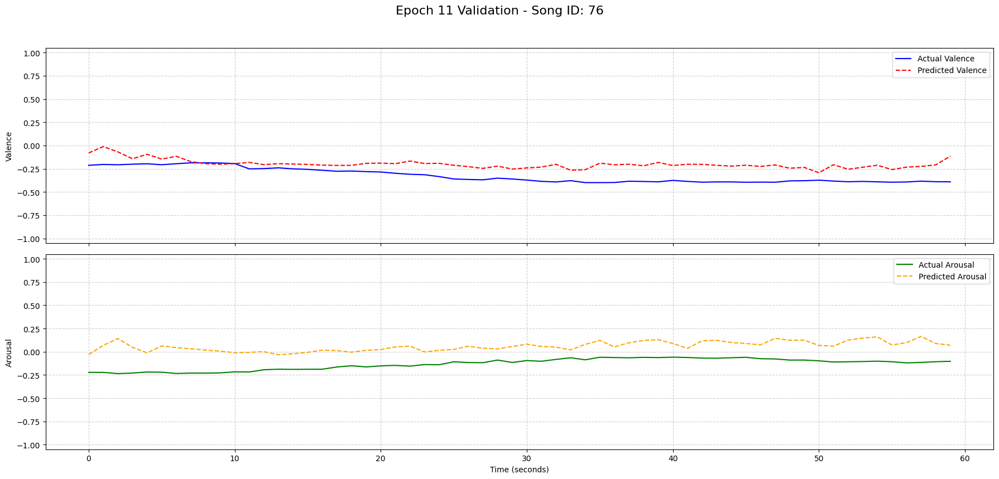

  → EarlyStopping counter: 2 out of 10
Epoch 12 | Train Loss: 0.0422 | Val Loss: 0.0421 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1597, R2(V/A): 0.1695/0.5362, CCC(V/A): 0.3282/0.7026


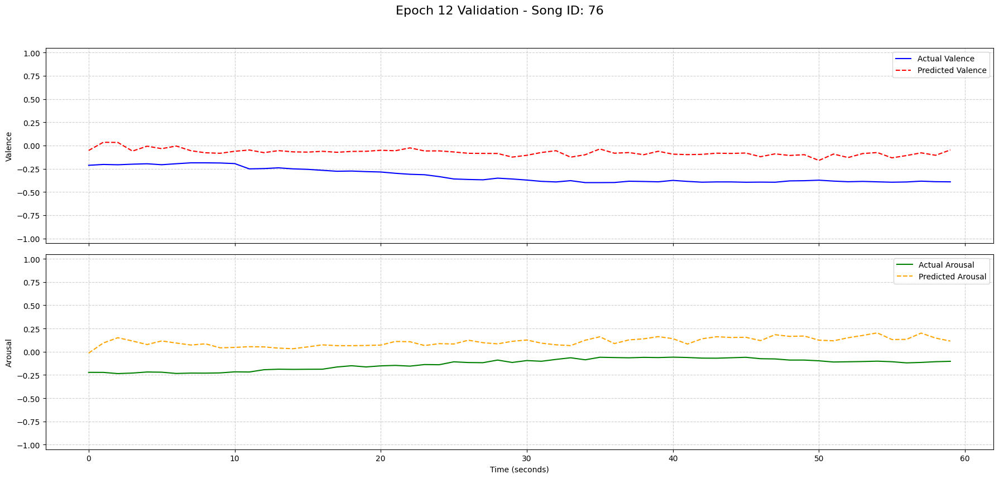

  → Validation loss decreased (0.0457 --> 0.0421). Saving model...
Epoch 13 | Train Loss: 0.0422 | Val Loss: 0.0429 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1637, R2(V/A): 0.1567/0.5268, CCC(V/A): 0.3347/0.6561


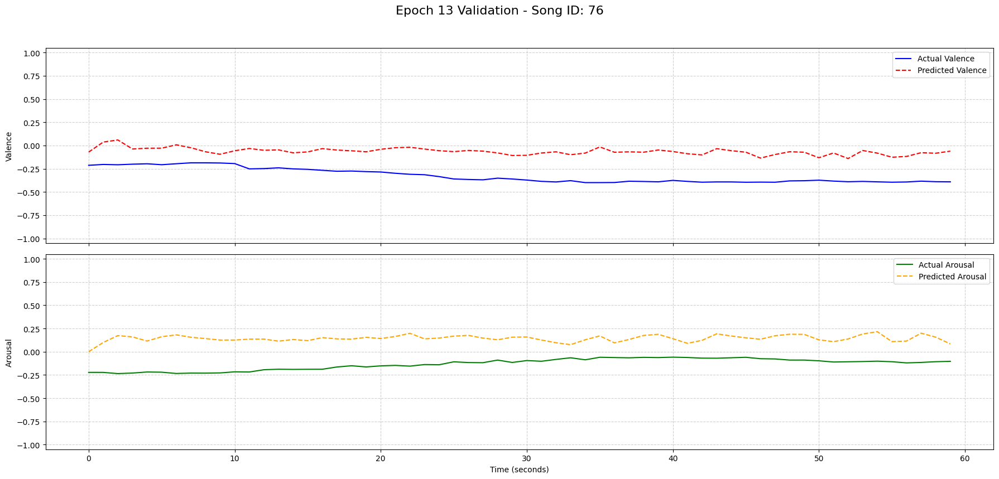

  → EarlyStopping counter: 1 out of 10
Epoch 14 | Train Loss: 0.0418 | Val Loss: 0.0431 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1652, R2(V/A): 0.1175/0.5475, CCC(V/A): 0.2912/0.6804


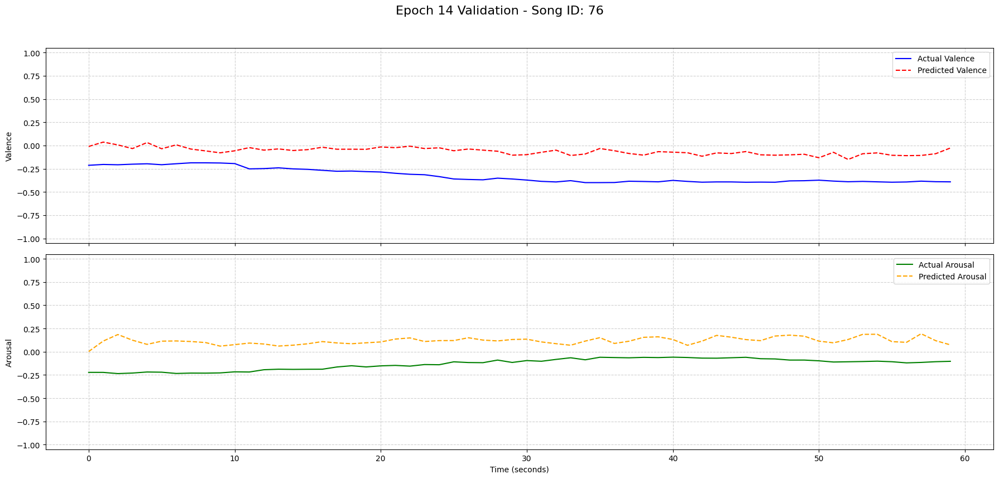

  → EarlyStopping counter: 2 out of 10
Epoch 15 | Train Loss: 0.0418 | Val Loss: 0.0418 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1604, R2(V/A): 0.1567/0.5523, CCC(V/A): 0.3368/0.7110


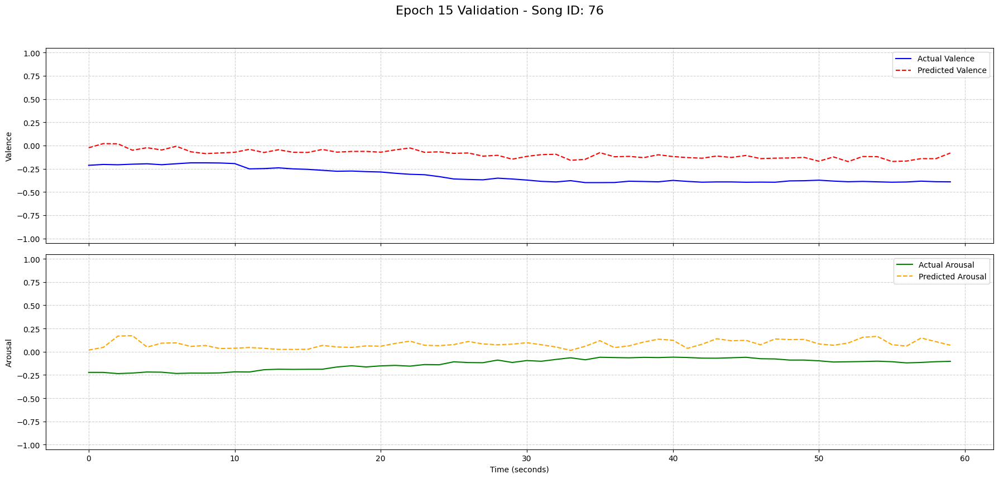

  → Validation loss decreased (0.0421 --> 0.0418). Saving model...
Epoch 16 | Train Loss: 0.0411 | Val Loss: 0.0428 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1610, R2(V/A): 0.1477/0.5333, CCC(V/A): 0.3461/0.6904


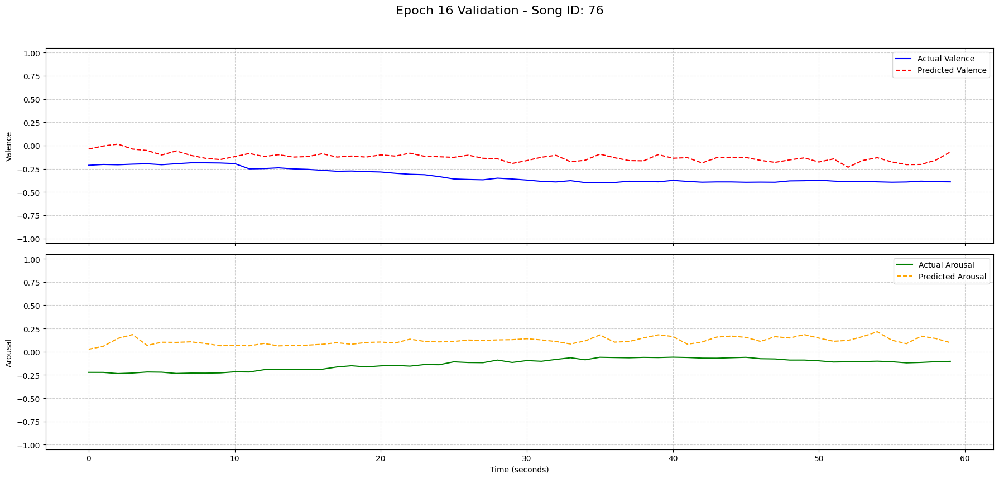

  → EarlyStopping counter: 1 out of 10
Epoch 17 | Train Loss: 0.0411 | Val Loss: 0.0433 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1658, R2(V/A): 0.1010/0.5552, CCC(V/A): 0.3365/0.7032


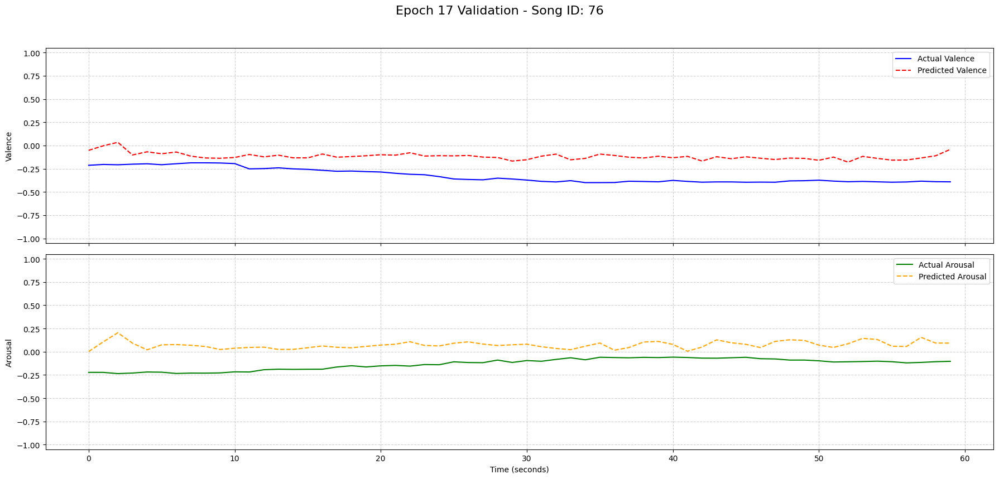

  → EarlyStopping counter: 2 out of 10
Epoch 18 | Train Loss: 0.0404 | Val Loss: 0.0434 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1612, R2(V/A): 0.0938/0.5584, CCC(V/A): 0.3843/0.7304


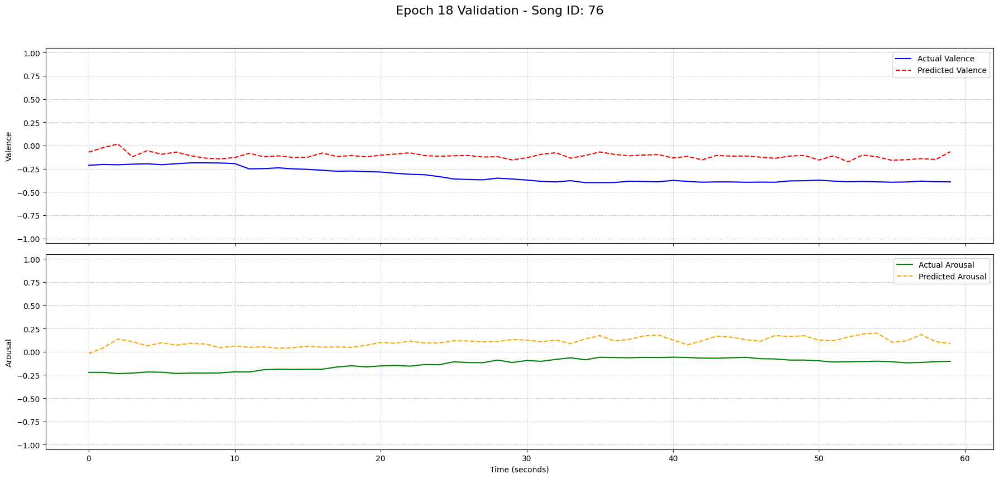

  → EarlyStopping counter: 3 out of 10
Epoch 19 | Train Loss: 0.0396 | Val Loss: 0.0470 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1745, R2(V/A): -0.0355/0.5591, CCC(V/A): 0.2442/0.6914


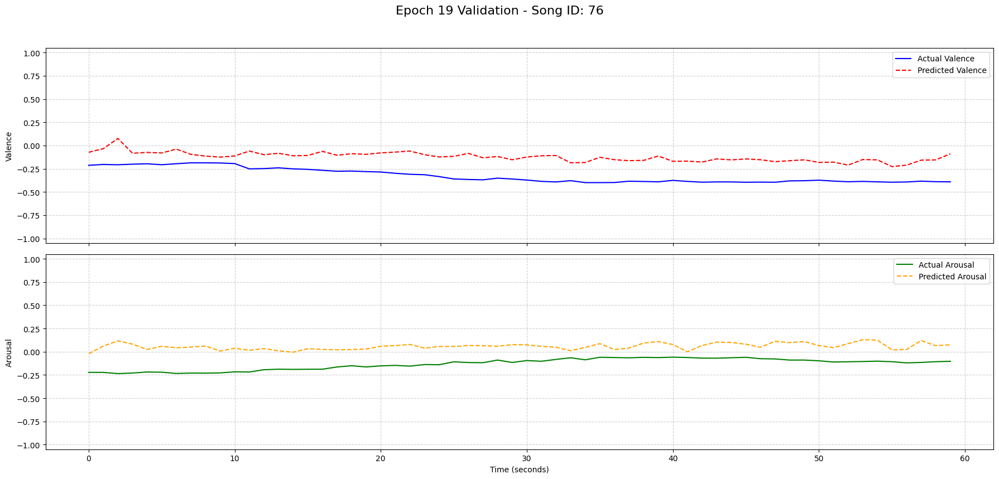

  → EarlyStopping counter: 4 out of 10
Epoch 20 | Train Loss: 0.0395 | Val Loss: 0.0444 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1675, R2(V/A): 0.1187/0.5153, CCC(V/A): 0.3187/0.6538


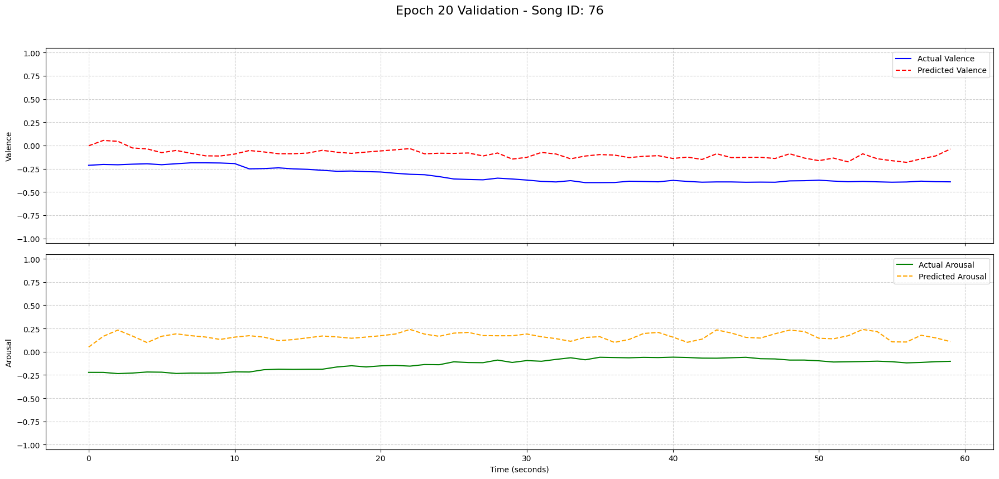

  → EarlyStopping counter: 5 out of 10
Epoch 21 | Train Loss: 0.0393 | Val Loss: 0.0473 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1720, R2(V/A): -0.0463/0.5604, CCC(V/A): 0.3139/0.7023


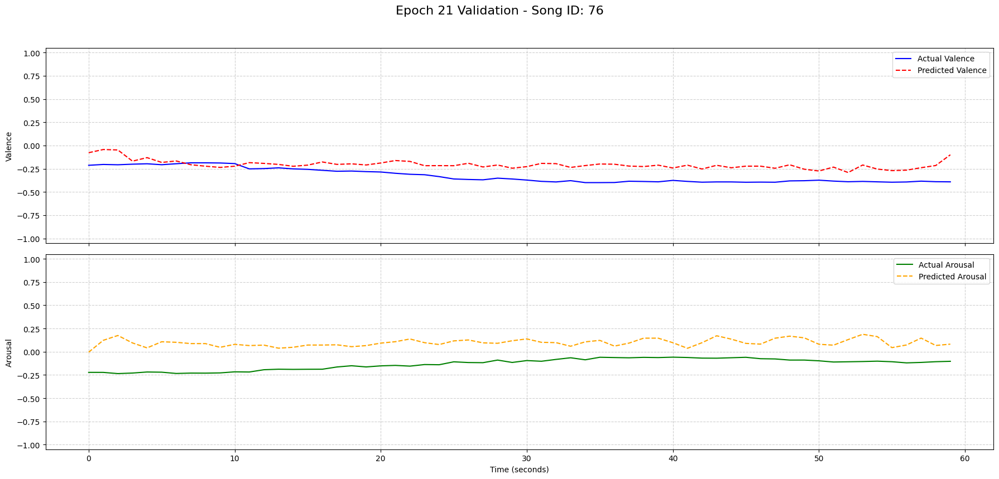

  → EarlyStopping counter: 6 out of 10
Epoch 22 | Train Loss: 0.0389 | Val Loss: 0.0471 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1703, R2(V/A): -0.0498/0.5666, CCC(V/A): 0.3385/0.7274


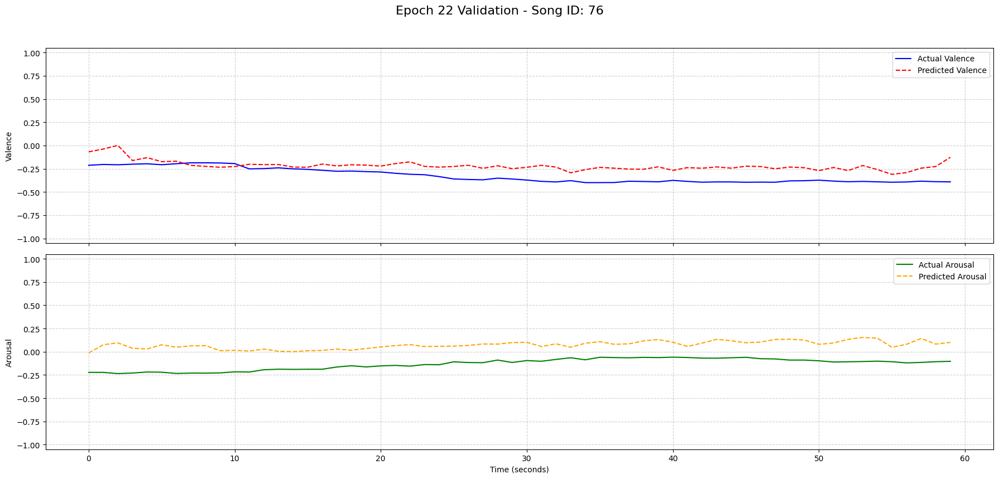

  → EarlyStopping counter: 7 out of 10
Epoch 23 | Train Loss: 0.0381 | Val Loss: 0.0517 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1852, R2(V/A): -0.1381/0.5151, CCC(V/A): 0.3036/0.6672


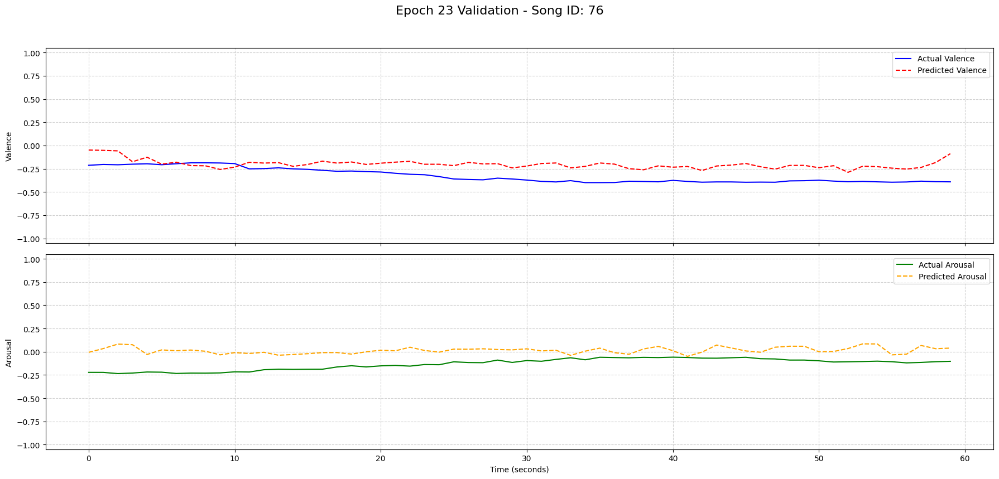

  → EarlyStopping counter: 8 out of 10
Epoch 24 | Train Loss: 0.0392 | Val Loss: 0.0424 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1605, R2(V/A): 0.1669/0.5297, CCC(V/A): 0.3503/0.6892


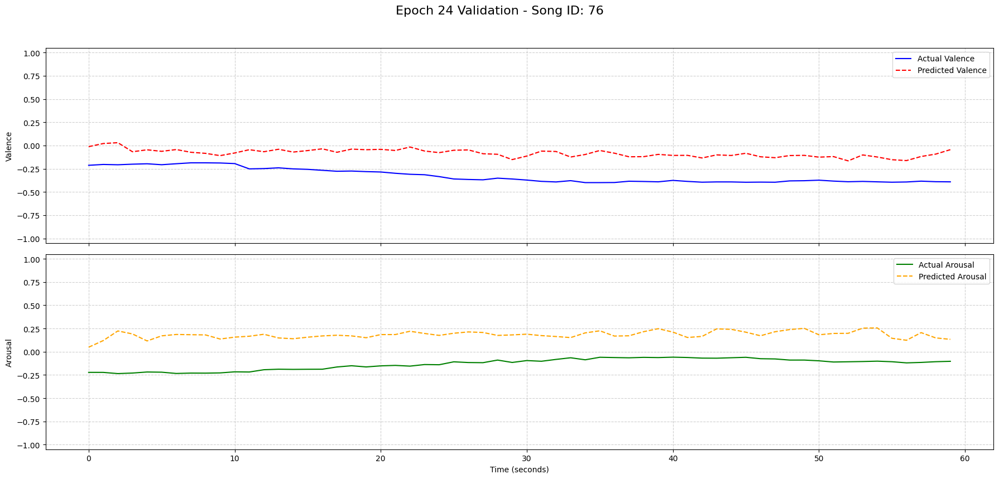

  → EarlyStopping counter: 9 out of 10
Epoch 25 | Train Loss: 0.0383 | Val Loss: 0.0474 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1754, R2(V/A): -0.0409/0.5538, CCC(V/A): 0.3043/0.6858


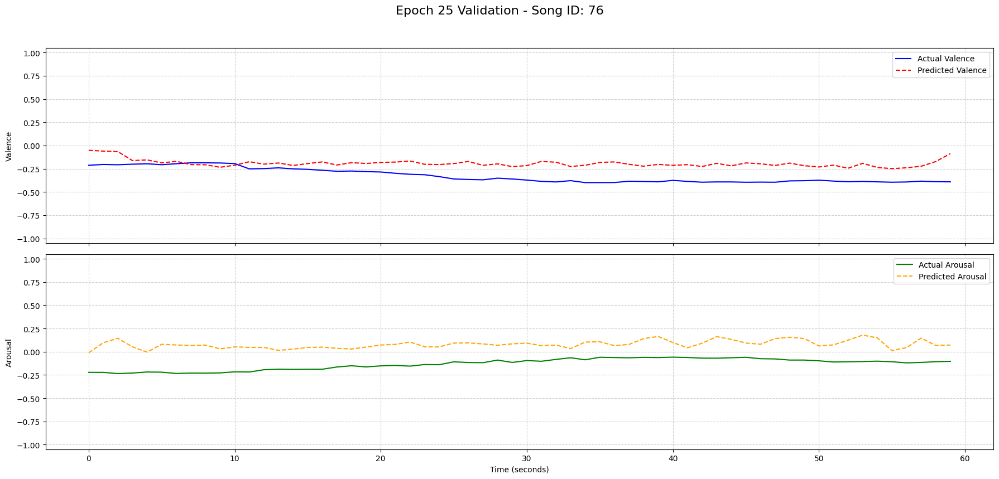

  → EarlyStopping counter: 10 out of 10

Early stopping at epoch 25. (Best Val Loss: 0.0418 @ epoch 15)

Training complete. Best model saved from epoch 15 with validation loss 0.0418.


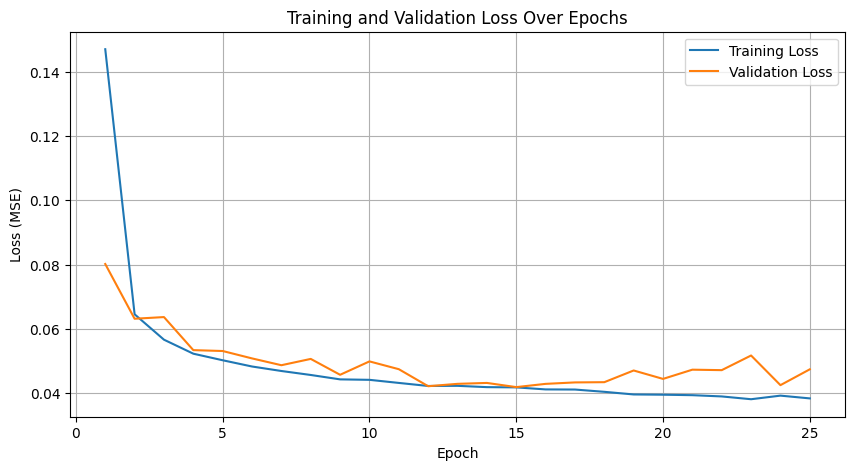


--- Starting Final Evaluation on Test Set ---


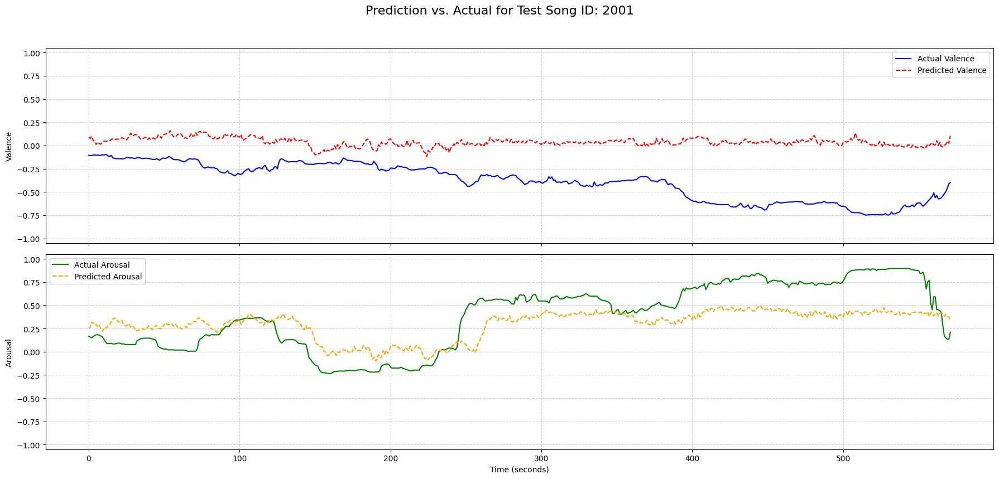

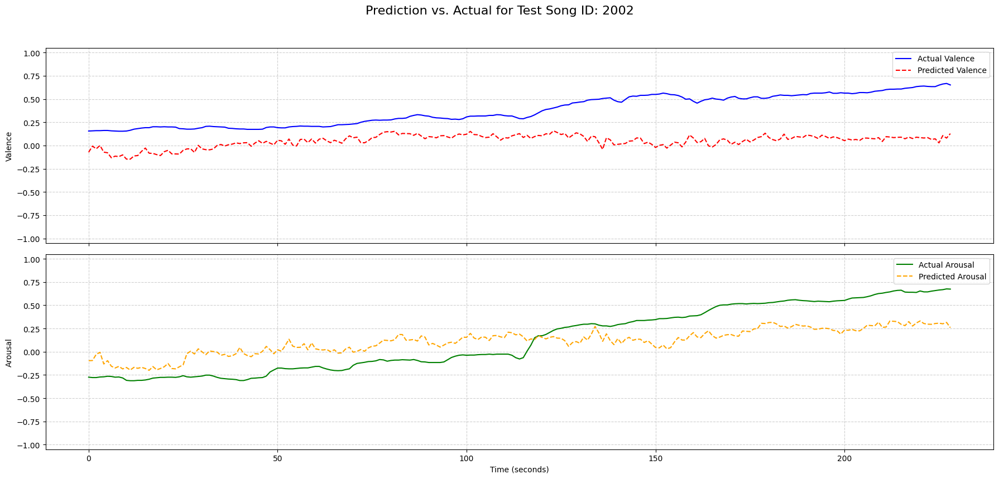

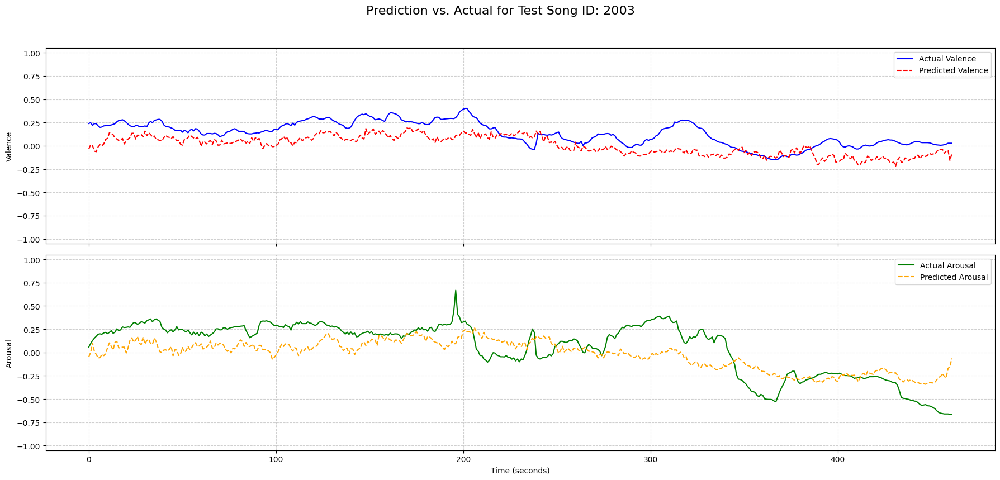

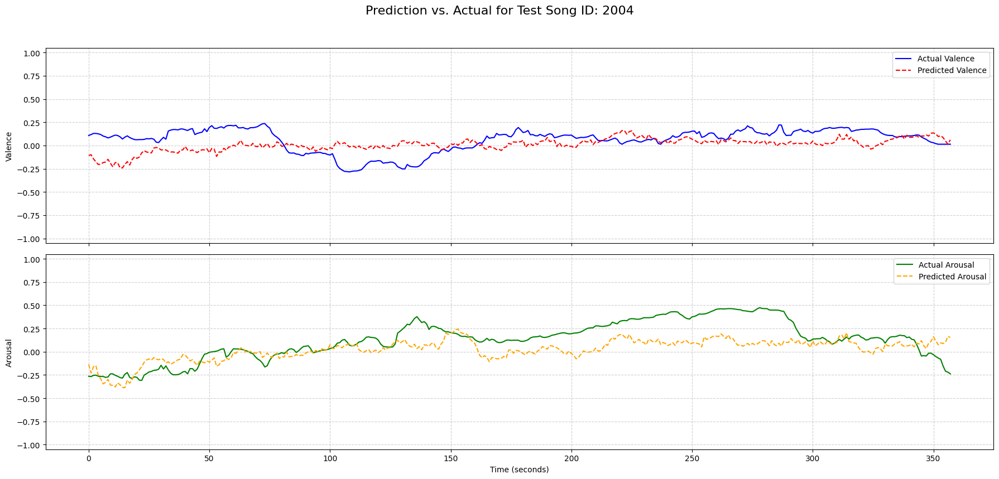

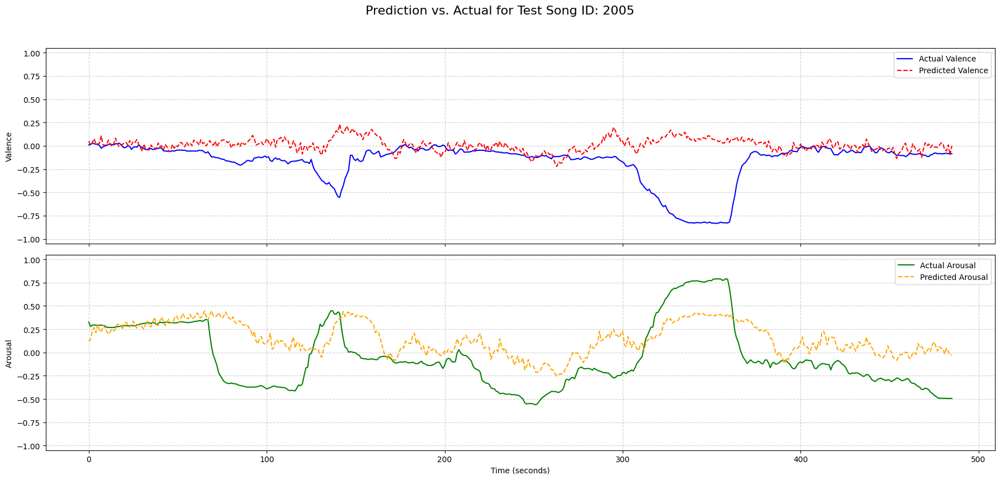

...

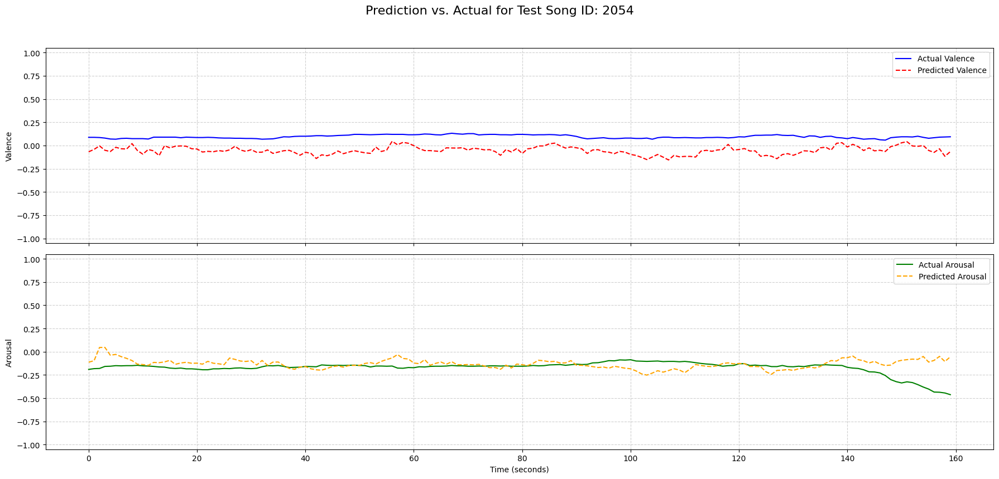

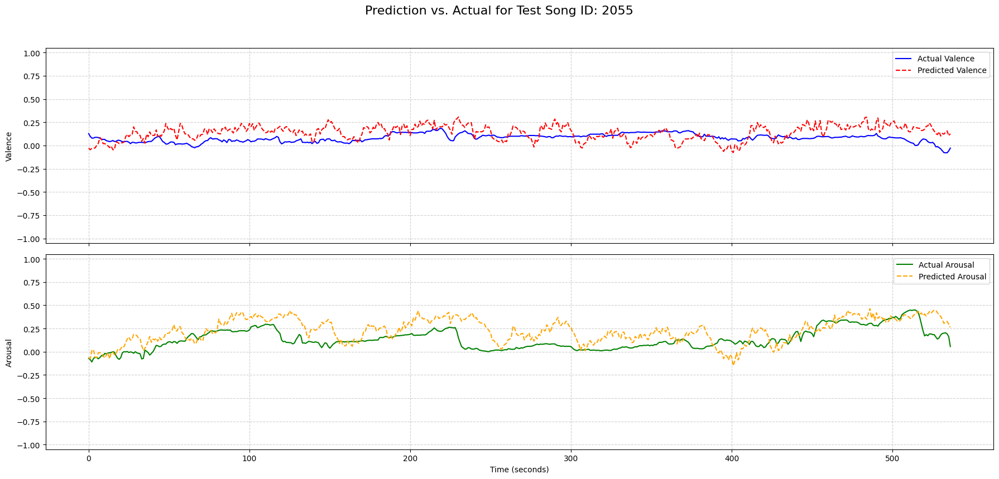

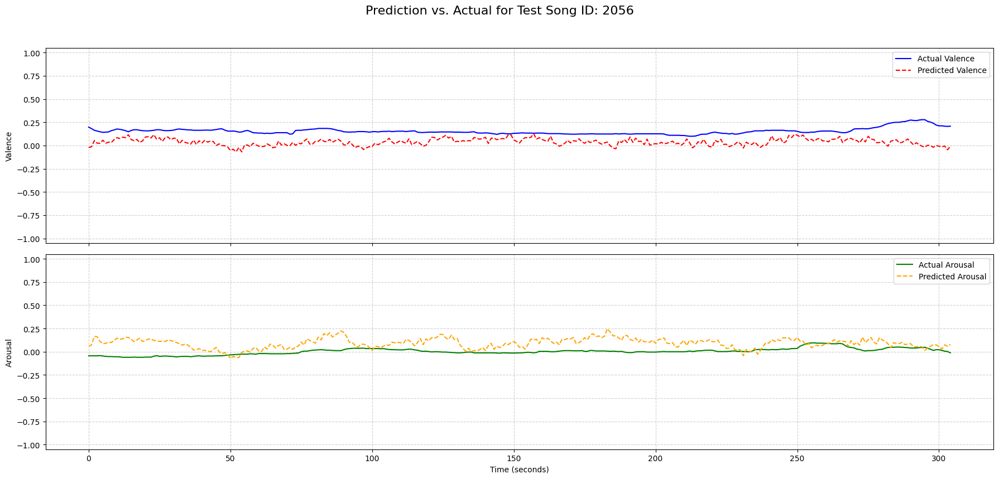

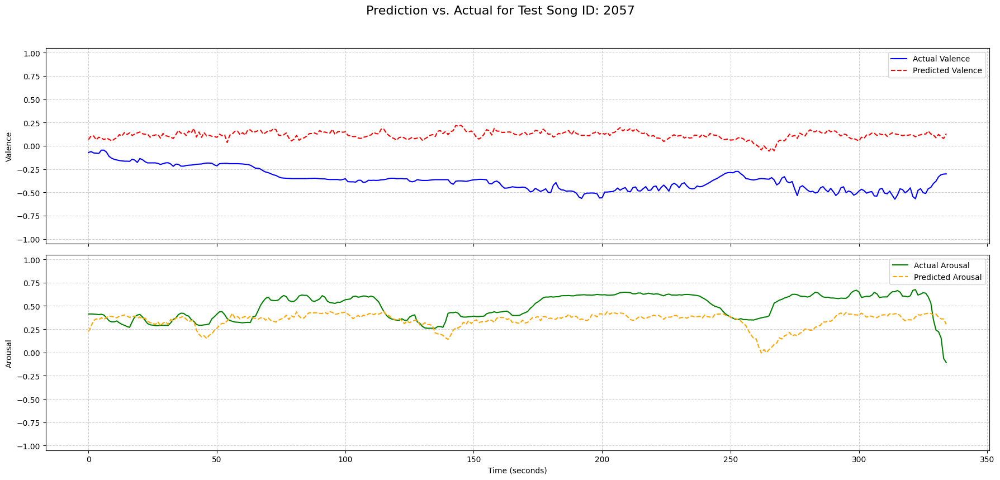

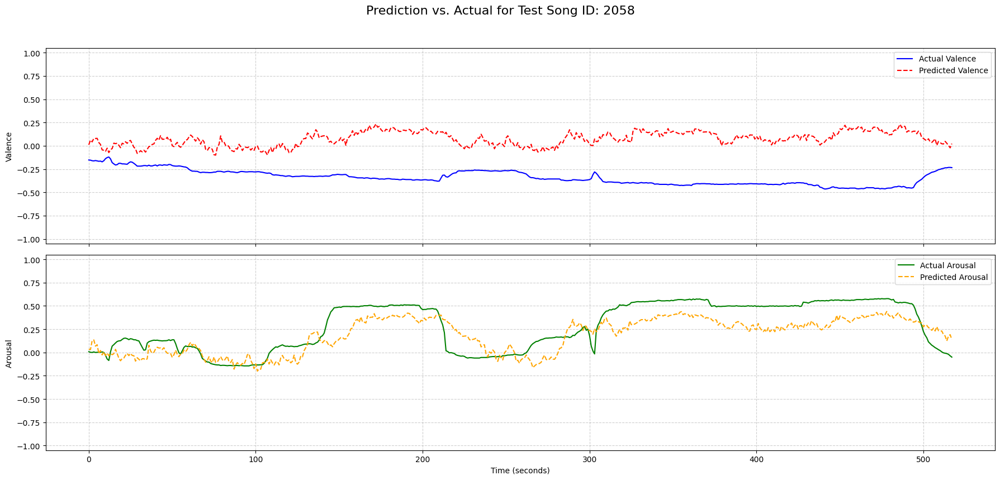


--- Final Test Set Performance ---
Average Test MSE Loss: 0.0737
Test MAE: 0.2133
Test R² (Valence/Arousal): -0.2001 / 0.3676
Test CCC (Valence/Arousal): -0.0250 / 0.5805
--- Evaluation Complete ---


In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 0) 라이브러리 임포트
# ──────────────────────────────────────────────────────────────────────────────
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score

# ──────────────────────────────────────────────────────────────────────────────
# 1) 데이터셋 로드 & 분할
# ──────────────────────────────────────────────────────────────────────────────
# Load the pre-processed dataset
raw = torch.load('DEAM_dataset_cleaned.pt')

# Extract data from the dictionary
clean_specs = raw['spectrograms']   # Tensor list or Tensor of shape (N,1,128,60)
clean_anns  = raw['annotations']    # Tensor list or Tensor of shape (N,60,2)
clean_ids   = raw['song_ids']       # list or Tensor of shape (N,)

# Build a unified list of dictionaries for easier handling
N = len(clean_ids)
data_list = []
for i in range(N):
    song_id = int(clean_ids[i])
    spec    = clean_specs[i]   # Tensor[1,128,60]
    ann     = clean_anns[i]    # Tensor[60,2]
    data_list.append({'song_id': song_id, 'spec': spec, 'ann': ann})

# ──────────────────────────────────────────────────────────────────────────────
# 2) Train/Val/Test 분할 (노래 ID 기준)
# ──────────────────────────────────────────────────────────────────────────────
train_val_ids = {d['song_id'] for d in data_list if d['song_id'] <= 2000}
test_ids      = {d['song_id'] for d in data_list if d['song_id']  > 2000}

class DEAMDataset(Dataset):
    def __init__(self, items, id_set):
        self.samples = [d for d in items if d['song_id'] in id_set]
    def __len__(self):
        return len(self.samples)
    def __getitem__(self, idx):
        # Return spectrogram, annotation, and song_id
        sample = self.samples[idx]
        return sample['spec'], sample['ann'], sample['song_id']

train_val_ds = DEAMDataset(data_list, train_val_ids)
test_ds      = DEAMDataset(data_list, test_ids)

# Reserve 10% of the training/validation set for validation
val_ratio = 0.15
val_size  = int(len(train_val_ds) * val_ratio)
train_size = len(train_val_ds) - val_size
train_ds, val_ds = random_split(
    train_val_ds,
    [train_size, val_size],
    generator=torch.Generator().manual_seed(42)
)

# ──────────────────────────────────────────────────────────────────────────────
# 3) DataLoader 설정
# ──────────────────────────────────────────────────────────────────────────────
batch_size  = 16
num_workers = 2 # 4 may cause warnings/errors in some environments

train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True,  num_workers=num_workers)
val_loader   = DataLoader(val_ds,   batch_size=batch_size, shuffle=False, num_workers=num_workers) # No need to shuffle validation
test_loader  = DataLoader(test_ds,  batch_size=1,          shuffle=False, num_workers=num_workers)

# ──────────────────────────────────────────────────────────────────────────────
# 4) 모델 정의 (DetailedEmotionCNN)
# ──────────────────────────────────────────────────────────────────────────────
class DetailedEmotionCNN(nn.Module):
    def __init__(self, dropout_cfg=(0.2, 0.2, 0.3, 0.3), negative_slope=0.8):
        super().__init__()
        d1, d2, d3, d4 = dropout_cfg
        nl = negative_slope

        self.block1 = nn.Sequential(
            nn.Conv2d(1, 16, kernel_size=3, padding=1), nn.BatchNorm2d(16),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Conv2d(16, 16, kernel_size=3, padding=1), nn.BatchNorm2d(16),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Dropout(d1), nn.MaxPool2d((2, 1), stride=(2, 1)),
        )
        self.block2 = nn.Sequential(
            nn.Conv2d(16, 32, kernel_size=3, padding=1), nn.BatchNorm2d(32),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Conv2d(32, 32, kernel_size=3, padding=1), nn.BatchNorm2d(32),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Dropout(d2), nn.MaxPool2d((2, 1), stride=(2, 1)),
        )
        self.block3 = nn.Sequential(
            nn.Conv2d(32, 64, kernel_size=3, padding=1), nn.BatchNorm2d(64),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Conv2d(64, 64, kernel_size=3, padding=1), nn.BatchNorm2d(64),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Dropout(d3), nn.MaxPool2d((2, 1), stride=(2, 1)),
        )
        self.block4 = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, padding=1), nn.BatchNorm2d(128),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Conv2d(128, 128, kernel_size=3, padding=1), nn.BatchNorm2d(128),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Dropout(d4), nn.MaxPool2d((2, 1), stride=(2, 1)),
            nn.Conv2d(128, 128, kernel_size=3, padding=1), nn.BatchNorm2d(128),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.MaxPool2d((8, 1), stride=(8, 1)),
        )
        self.conv_out = nn.Conv2d(128, 2, kernel_size=1)

    def forward(self, x):
        x = self.block1(x)
        x = self.block2(x)
        x = self.block3(x)
        x = self.block4(x)
        x = self.conv_out(x)
        x = x.squeeze(2)
        x = x.permute(0, 2, 1)
        return torch.tanh(x)

# ──────────────────────────────────────────────────────────────────────────────
# 5) 시각화 헬퍼 함수 및 지표 정의
# ──────────────────────────────────────────────────────────────────────────────
def plot_predictions(actual, pred, title=""):
    """Generates and displays a plot comparing actual and predicted valence/arousal."""
    actual_np = actual.detach().cpu().numpy()
    pred_np = pred.detach().cpu().numpy()

    time_steps = np.arange(actual_np.shape[0])

    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(18, 9), sharex=True)
    fig.suptitle(title, fontsize=16)

    # Valence Plot
    ax1.plot(time_steps, actual_np[:, 0], 'b-', label='Actual Valence')
    ax1.plot(time_steps, pred_np[:, 0], 'r--', label='Predicted Valence')
    ax1.set_ylabel('Valence')
    ax1.set_ylim(-1.05, 1.05)
    ax1.legend()
    ax1.grid(True, linestyle='--', alpha=0.6)

    # Arousal Plot
    ax2.plot(time_steps, actual_np[:, 1], color='green', linestyle='-', label='Actual Arousal')
    ax2.plot(time_steps, pred_np[:, 1], color='orange', linestyle='--', label='Predicted Arousal')
    ax2.set_xlabel('Time (seconds)')
    ax2.set_ylabel('Arousal')
    ax2.set_ylim(-1.05, 1.05)
    ax2.legend()
    ax2.grid(True, linestyle='--', alpha=0.6)

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()


def concordance_correlation_coefficient(y_true, y_pred):
    """Calculates the Concordance Correlation Coefficient."""
    true_mean, pred_mean = np.mean(y_true), np.mean(y_pred)
    true_var, pred_var = np.var(y_true), np.var(y_pred)
    covariance = np.mean((y_true - true_mean) * (y_pred - pred_mean))
    ccc = (2 * covariance) / (true_var + pred_var + (true_mean - pred_mean)**2 + 1e-8)
    return ccc

# ──────────────────────────────────────────────────────────────────────────────
# 6) 학습 설정
# ──────────────────────────────────────────────────────────────────────────────
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = DetailedEmotionCNN().to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-7)
criterion = nn.MSELoss()
scheduler = optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, mode='min', factor=0.5, patience=10, verbose=True
)

num_epochs = 50
best_val_loss = float('inf')
early_stop_patience = 10
early_stop_counter = 0

# History tracking
train_loss_history = []
val_loss_history = []

print(f"Using device: {device}")
total_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f"Model has {total_params:,} trainable parameters.")

# ──────────────────────────────────────────────────────────────────────────────
# 7) 학습 루프 (Train / Validation / Scheduler / Checkpoint / Visualization)
# ──────────────────────────────────────────────────────────────────────────────
for epoch in range(1, num_epochs + 1):
    # --- TRAIN ---
    model.train()
    running_train_loss = 0.0
    for spec, ann, _ in train_loader:
        spec, ann = spec.to(device), ann.to(device)
        optimizer.zero_grad()
        pred = model(spec)
        loss = criterion(pred, ann)
        loss.backward()
        optimizer.step()
        running_train_loss += loss.item() * spec.size(0)
    train_loss = running_train_loss / len(train_loader.dataset.indices)
    train_loss_history.append(train_loss)

    # --- VALIDATION ---
    model.eval()
    running_val_loss = 0.0
    all_preds, all_trues = [], []
    last_val_batch = {} # For visualization

    with torch.no_grad():
        for i, (spec, ann, ids) in enumerate(val_loader):
            spec, ann = spec.to(device), ann.to(device)
            pred = model(spec)
            running_val_loss += criterion(pred, ann).item() * spec.size(0)

            all_preds.append(pred.cpu().numpy().reshape(-1, 2))
            all_trues.append(ann.cpu().numpy().reshape(-1, 2))

            # Store the first batch for end-of-epoch visualization
            if i == 0:
                last_val_batch['ann'] = ann[0]
                last_val_batch['pred'] = pred[0]
                last_val_batch['id'] = ids[0]

    val_loss = running_val_loss / len(val_loader.dataset.indices)
    val_loss_history.append(val_loss)

    preds_np = np.vstack(all_preds)
    trues_np = np.vstack(all_trues)

    # --- Calculate Metrics ---
    mae = np.mean(np.abs(preds_np - trues_np))
    r2_val = r2_score(trues_np[:, 0], preds_np[:, 0])
    r2_aro = r2_score(trues_np[:, 1], preds_np[:, 1])
    ccc_val = concordance_correlation_coefficient(trues_np[:, 0], preds_np[:, 0])
    ccc_aro = concordance_correlation_coefficient(trues_np[:, 1], preds_np[:, 1])

    # --- Log & Visualize ---
    lr = optimizer.param_groups[0]['lr']
    print(f"Epoch {epoch:02d} | Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f} | LR: {lr:.2e}")
    print(f"  → Val Metrics: MAE: {mae:.4f}, R2(V/A): {r2_val:.4f}/{r2_aro:.4f}, CCC(V/A): {ccc_val:.4f}/{ccc_aro:.4f}")

    # Plot predictions for a sample from the validation set
    plot_title = f"Epoch {epoch:02d} Validation - Song ID: {last_val_batch['id']}"
    plot_predictions(last_val_batch['ann'], last_val_batch['pred'], title=plot_title)

    # --- Scheduler, Checkpoint & EarlyStopping ---
    scheduler.step(val_loss)
    if val_loss < best_val_loss:
        print(f"  → Validation loss decreased ({best_val_loss:.4f} --> {val_loss:.4f}). Saving model...")
        best_val_loss = val_loss
        torch.save(model.state_dict(), 'best_emotion_cnn.pt')
        early_stop_counter = 0
        best_epoch = epoch
    else:
        early_stop_counter += 1
        print(f"  → EarlyStopping counter: {early_stop_counter} out of {early_stop_patience}")

    if early_stop_counter >= early_stop_patience:
        print(f"\nEarly stopping at epoch {epoch}. (Best Val Loss: {best_val_loss:.4f} @ epoch {best_epoch})")
        break

print(f"\nTraining complete. Best model saved from epoch {best_epoch} with validation loss {best_val_loss:.4f}.")

# ──────────────────────────────────────────────────────────────────────────────
# 8) 학습 과정 시각화 (Loss Curve)
# ──────────────────────────────────────────────────────────────────────────────
plt.figure(figsize=(10, 5))
plt.plot(range(1, len(train_loss_history) + 1), train_loss_history, label='Training Loss')
plt.plot(range(1, len(val_loss_history) + 1), val_loss_history, label='Validation Loss')
plt.title('Training and Validation Loss Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss (MSE)')
plt.legend()
plt.grid(True)
plt.show()

# ──────────────────────────────────────────────────────────────────────────────
# 9) 테스트 및 최종 평가
# ──────────────────────────────────────────────────────────────────────────────
print("\n--- Starting Final Evaluation on Test Set ---")
# Load the best performing model
model.load_state_dict(torch.load('best_emotion_cnn.pt'))
model.to(device)
model.eval()

test_loss = 0.0
all_test_preds, all_test_trues = [], []

with torch.no_grad():
    for spec, ann, song_id in test_loader:
        spec, ann = spec.to(device), ann.to(device)
        pred = model(spec)

        # Squeeze batch dimension for single-item batch
        spec_sq, ann_sq, pred_sq = spec.squeeze(0), ann.squeeze(0), pred.squeeze(0)
        song_id_item = song_id.item()

        # Accumulate loss
        loss = criterion(pred, ann)
        test_loss += loss.item()

        # Store predictions and true values for aggregate metrics
        all_test_preds.append(pred_sq.cpu().numpy())
        all_test_trues.append(ann_sq.cpu().numpy())

        # Visualize the prediction for this test song
        plot_title = f"Prediction vs. Actual for Test Song ID: {song_id_item}"
        plot_predictions(ann_sq, pred_sq, title=plot_title)

# --- Calculate and Print Final Test Metrics ---
final_test_loss = test_loss / len(test_loader)
test_preds_np = np.vstack(all_test_preds)
test_trues_np = np.vstack(all_test_trues)

test_mae = np.mean(np.abs(test_preds_np - test_trues_np))
test_r2_val = r2_score(test_trues_np[:, 0], test_preds_np[:, 0])
test_r2_aro = r2_score(test_trues_np[:, 1], test_preds_np[:, 1])
test_ccc_val = concordance_correlation_coefficient(test_trues_np[:, 0], test_preds_np[:, 0])
test_ccc_aro = concordance_correlation_coefficient(test_trues_np[:, 1], test_preds_np[:, 1])

print("\n--- Final Test Set Performance ---")
print(f"Average Test MSE Loss: {final_test_loss:.4f}")
print(f"Test MAE: {test_mae:.4f}")
print(f"Test R² (Valence/Arousal): {test_r2_val:.4f} / {test_r2_aro:.4f}")
print(f"Test CCC (Valence/Arousal): {test_ccc_val:.4f} / {test_ccc_aro:.4f}")
print("--- Evaluation Complete ---")

##CNN + Decoder Only


In [ ]:
!pip install transformers -q # First-time setup: install transformers

In [ ]:
# ──────────────────────────────────────────────────────────────────────────────
# 0) 라이브러리 임포트
# ──────────────────────────────────────────────────────────────────────────────

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score
from transformers import GPT2Model, GPT2Config

# ──────────────────────────────────────────────────────────────────────────────
# 1) 데이터셋 로드 & 분할
# ──────────────────────────────────────────────────────────────────────────────
# Load the pre-processed dataset
raw = torch.load('DEAM_dataset_cleaned.pt')

# Extract data from the dictionary
clean_specs = raw['spectrograms']   # Tensor list or Tensor of shape (N,1,128,60)
clean_anns  = raw['annotations']    # Tensor list or Tensor of shape (N,60,2)
clean_ids   = raw['song_ids']       # list or Tensor of shape (N,)

# Build a unified list of dictionaries for easier handling
N = len(clean_ids)
data_list = []
for i in range(N):
    song_id = int(clean_ids[i])
    spec    = clean_specs[i]   # Tensor[1,128,60]
    ann     = clean_anns[i]    # Tensor[60,2]
    data_list.append({'song_id': song_id, 'spec': spec, 'ann': ann})

# ──────────────────────────────────────────────────────────────────────────────
# 2) Train/Val/Test 분할 (노래 ID 기준)
# ──────────────────────────────────────────────────────────────────────────────
train_val_ids = {d['song_id'] for d in data_list if d['song_id'] <= 2000}
test_ids      = {d['song_id'] for d in data_list if d['song_id']  > 2000}

class DEAMDataset(Dataset):
    def __init__(self, items, id_set):
        self.samples = [d for d in items if d['song_id'] in id_set]
    def __len__(self):
        return len(self.samples)
    def __getitem__(self, idx):
        # Return spectrogram, annotation, and song_id
        sample = self.samples[idx]
        return sample['spec'], sample['ann'], sample['song_id']

train_val_ds = DEAMDataset(data_list, train_val_ids)
test_ds      = DEAMDataset(data_list, test_ids)

# Reserve 10% of the training/validation set for validation
val_ratio = 0.1
val_size  = int(len(train_val_ds) * val_ratio)
train_size = len(train_val_ds) - val_size
train_ds, val_ds = random_split(
    train_val_ds,
    [train_size, val_size],
    generator=torch.Generator().manual_seed(42)
)

# ──────────────────────────────────────────────────────────────────────────────
# 3) DataLoader 설정
# ──────────────────────────────────────────────────────────────────────────────
batch_size  = 16
num_workers = 2 # 4 may cause warnings/errors in some environments

train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True,  num_workers=num_workers)
val_loader   = DataLoader(val_ds,   batch_size=batch_size, shuffle=False, num_workers=num_workers) # No need to shuffle validation
test_loader  = DataLoader(test_ds,  batch_size=1,          shuffle=False, num_workers=num_workers)

# ──────────────────────────────────────────────────────────────────────────────
# 4) 모델 정의 (CNNTransformer)
# ──────────────────────────────────────────────────────────────────────────────
class CNNTransformer(nn.Module):
    def __init__(self, dropout_cfg=(0.2, 0.2, 0.3, 0.3), negative_slope=0.5,
                 n_layers=4, n_heads=4, trans_dropout=0.2):
        super().__init__()

        # --- CNN Backbone ---
        d1, d2, d3, d4 = dropout_cfg
        nl = negative_slope
        self.cnn_backbone = nn.Sequential(
            # Block 1
            nn.Conv2d(1, 16, kernel_size=3, padding=1), nn.BatchNorm2d(16),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Conv2d(16, 16, kernel_size=3, padding=1), nn.BatchNorm2d(16),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Dropout(d1), nn.MaxPool2d((2, 1), stride=(2, 1)),
            # Block 2
            nn.Conv2d(16, 32, kernel_size=3, padding=1), nn.BatchNorm2d(32),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Conv2d(32, 32, kernel_size=3, padding=1), nn.BatchNorm2d(32),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Dropout(d2), nn.MaxPool2d((2, 1), stride=(2, 1)),
            # Block 3
            nn.Conv2d(32, 64, kernel_size=3, padding=1), nn.BatchNorm2d(64),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Conv2d(64, 64, kernel_size=3, padding=1), nn.BatchNorm2d(64),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Dropout(d3), nn.MaxPool2d((2, 1), stride=(2, 1)),
            # Block 4
            nn.Conv2d(64, 128, kernel_size=3, padding=1), nn.BatchNorm2d(128),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Conv2d(128, 128, kernel_size=3, padding=1), nn.BatchNorm2d(128),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Dropout(d4), nn.MaxPool2d((2, 1), stride=(2, 1)),
            nn.Conv2d(128, 128, kernel_size=3, padding=1), nn.BatchNorm2d(128),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.MaxPool2d((8, 1), stride=(8, 1)),
        )

        # --- Transformer Decoder ---
        # CNN output is [B, 128, 1, 60], which becomes [B, 60, 128] for the transformer.
        # So, the embedding dimension (n_embd) must be 128.
        config = GPT2Config(
            vocab_size=1,  # Not used, but required for the model
            n_positions=60, # Max sequence length
            n_embd=128,     # Feature dimension from CNN
            n_layer=n_layers,   # Number of transformer layers
            n_head=n_heads,     # Number of attention heads
            resid_pdrop=trans_dropout, # Dropout
            attn_pdrop=trans_dropout,  # Dropout
        )
        self.transformer = GPT2Model(config)

        # --- Prediction Head ---
        # Maps the transformer's output hidden states to our 2 emotion dimensions
        self.prediction_head = nn.Linear(128, 2)

    def forward(self, x):
        # x: [B, 1, 128, 60]

        # 1. Pass through CNN backbone
        x = self.cnn_backbone(x)  # -> [B, 128, 1, 60]

        # 2. Reshape for Transformer
        x = x.squeeze(2)          # -> [B, 128, 60]
        x = x.permute(0, 2, 1)    # -> [B, 60, 128] (Batch, Seq_Len, Emb_Dim)

        # 3. Pass through Transformer
        # We pass the CNN features directly as `inputs_embeds`
        transformer_outputs = self.transformer(inputs_embeds=x)
        hidden_states = transformer_outputs.last_hidden_state # -> [B, 60, 128]

        # 4. Pass through Prediction Head
        predictions = self.prediction_head(hidden_states) # -> [B, 60, 2]

        # 5. Apply tanh activation to constrain output
        return torch.tanh(predictions)


# ──────────────────────────────────────────────────────────────────────────────
# 5) 시각화 헬퍼 함수 및 지표 정의
# ──────────────────────────────────────────────────────────────────────────────
def plot_predictions(actual, pred, title=""):
    """Generates and displays a plot comparing actual and predicted valence/arousal."""
    actual_np = actual.detach().cpu().numpy()
    pred_np = pred.detach().cpu().numpy()

    time_steps = np.arange(actual_np.shape[0])

    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(18, 9), sharex=True)
    fig.suptitle(title, fontsize=16)

    # Valence Plot
    ax1.plot(time_steps, actual_np[:, 0], 'b-', label='Actual Valence')
    ax1.plot(time_steps, pred_np[:, 0], 'r--', label='Predicted Valence')
    ax1.set_ylabel('Valence')
    ax1.set_ylim(-1.05, 1.05)
    ax1.legend()
    ax1.grid(True, linestyle='--', alpha=0.6)

    # Arousal Plot
    ax2.plot(time_steps, actual_np[:, 1], color='green', linestyle='-', label='Actual Arousal')
    ax2.plot(time_steps, pred_np[:, 1], color='orange', linestyle='--', label='Predicted Arousal')
    ax2.set_xlabel('Time (seconds)')
    ax2.set_ylabel('Arousal')
    ax2.set_ylim(-1.05, 1.05)
    ax2.legend()
    ax2.grid(True, linestyle='--', alpha=0.6)

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()


def concordance_correlation_coefficient(y_true, y_pred):
    """Calculates the Concordance Correlation Coefficient."""
    true_mean, pred_mean = np.mean(y_true), np.mean(y_pred)
    true_var, pred_var = np.var(y_true), np.var(y_pred)
    covariance = np.mean((y_true - true_mean) * (y_pred - pred_mean))
    ccc = (2 * covariance) / (true_var + pred_var + (true_mean - pred_mean)**2 + 1e-8)
    return ccc

# ──────────────────────────────────────────────────────────────────────────────
# 6) 학습 설정
# ──────────────────────────────────────────────────────────────────────────────
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# --- MODEL INSTANTIATION IS UPDATED HERE ---
model = CNNTransformer().to(device) # Using the new CNN-Transformer model
# -------------------------------------------

optimizer = optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-7) # Reduced LR for transformer
criterion = nn.MSELoss()
scheduler = optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, mode='min', factor=0.5, patience=5, verbose=True
)

num_epochs = 50
best_val_loss = float('inf')
early_stop_patience = 10
early_stop_counter = 0

# History tracking
train_loss_history = []
val_loss_history = []

print(f"Using device: {device}")
total_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f"Model has {total_params:,} trainable parameters.")


# ──────────────────────────────────────────────────────────────────────────────
# 7) 학습 루프 (Train / Validation / Scheduler / Checkpoint / Visualization)
# ──────────────────────────────────────────────────────────────────────────────
# THIS ENTIRE SECTION REMAINS THE SAME
for epoch in range(1, num_epochs + 1):
    # --- TRAIN ---
    model.train()
    running_train_loss = 0.0
    for spec, ann, _ in train_loader:
        spec, ann = spec.to(device), ann.to(device)
        optimizer.zero_grad()
        pred = model(spec)
        loss = criterion(pred, ann)
        loss.backward()
        optimizer.step()
        running_train_loss += loss.item() * spec.size(0)
    train_loss = running_train_loss / len(train_loader.dataset.indices)
    train_loss_history.append(train_loss)

    # --- VALIDATION ---
    model.eval()
    running_val_loss = 0.0
    all_preds, all_trues = [], []
    last_val_batch = {} # For visualization

    with torch.no_grad():
        for i, (spec, ann, ids) in enumerate(val_loader):
            spec, ann = spec.to(device), ann.to(device)
            pred = model(spec)
            running_val_loss += criterion(pred, ann).item() * spec.size(0)

            all_preds.append(pred.cpu().numpy().reshape(-1, 2))
            all_trues.append(ann.cpu().numpy().reshape(-1, 2))

            # Store the first batch for end-of-epoch visualization
            if i == 0:
                last_val_batch['ann'] = ann[0]
                last_val_batch['pred'] = pred[0]
                last_val_batch['id'] = ids[0]

    val_loss = running_val_loss / len(val_loader.dataset.indices)
    val_loss_history.append(val_loss)

    preds_np = np.vstack(all_preds)
    trues_np = np.vstack(all_trues)

    # --- Calculate Metrics ---
    mae = np.mean(np.abs(preds_np - trues_np))
    r2_val = r2_score(trues_np[:, 0], preds_np[:, 0])
    r2_aro = r2_score(trues_np[:, 1], preds_np[:, 1])
    ccc_val = concordance_correlation_coefficient(trues_np[:, 0], preds_np[:, 0])
    ccc_aro = concordance_correlation_coefficient(trues_np[:, 1], preds_np[:, 1])

    # --- Log & Visualize ---
    lr = optimizer.param_groups[0]['lr']
    print(f"Epoch {epoch:02d} | Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f} | LR: {lr:.2e}")
    print(f"  → Val Metrics: MAE: {mae:.4f}, R2(V/A): {r2_val:.4f}/{r2_aro:.4f}, CCC(V/A): {ccc_val:.4f}/{ccc_aro:.4f}")

    # Plot predictions for a sample from the validation set
    plot_title = f"Epoch {epoch:02d} Validation - Song ID: {last_val_batch['id']}"
    plot_predictions(last_val_batch['ann'], last_val_batch['pred'], title=plot_title)

    # --- Scheduler, Checkpoint & EarlyStopping ---
    scheduler.step(val_loss)
    if val_loss < best_val_loss:
        print(f"  → Validation loss decreased ({best_val_loss:.4f} --> {val_loss:.4f}). Saving model...")
        best_val_loss = val_loss
        torch.save(model.state_dict(), 'best_emotion_cnn_transformer.pt')
        early_stop_counter = 0
        best_epoch = epoch
    else:
        early_stop_counter += 1
        print(f"  → EarlyStopping counter: {early_stop_counter} out of {early_stop_patience}")

    if early_stop_counter >= early_stop_patience:
        print(f"\nEarly stopping at epoch {epoch}. (Best Val Loss: {best_val_loss:.4f} @ epoch {best_epoch})")
        break

print(f"\nTraining complete. Best model saved from epoch {best_epoch} with validation loss {best_val_loss:.4f}.")

# ──────────────────────────────────────────────────────────────────────────────
# 8) 학습 과정 시각화 (Loss Curve)
# ──────────────────────────────────────────────────────────────────────────────
plt.figure(figsize=(10, 5))
plt.plot(range(1, len(train_loss_history) + 1), train_loss_history, label='Training Loss')
plt.plot(range(1, len(val_loss_history) + 1), val_loss_history, label='Validation Loss')
plt.title('Training and Validation Loss Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss (MSE)')
plt.legend()
plt.grid(True)
plt.show()

# ──────────────────────────────────────────────────────────────────────────────
# 9) 테스트 및 최종 평가
# ──────────────────────────────────────────────────────────────────────────────
print("\n--- Starting Final Evaluation on Test Set ---")
# Load the best performing model
model.load_state_dict(torch.load('best_emotion_cnn_transformer.pt'))
model.to(device)
model.eval()

test_loss = 0.0
all_test_preds, all_test_trues = [], []

with torch.no_grad():
    for spec, ann, song_id in test_loader:
        spec, ann = spec.to(device), ann.to(device)
        pred = model(spec)

        # Squeeze batch dimension for single-item batch
        spec_sq, ann_sq, pred_sq = spec.squeeze(0), ann.squeeze(0), pred.squeeze(0)
        song_id_item = song_id.item()

        # Accumulate loss
        loss = criterion(pred, ann)
        test_loss += loss.item()

        # Store predictions and true values for aggregate metrics
        all_test_preds.append(pred_sq.cpu().numpy())
        all_test_trues.append(ann_sq.cpu().numpy())

        # Visualize the prediction for this test song
        plot_title = f"Prediction vs. Actual for Test Song ID: {song_id_item}"
        plot_predictions(ann_sq, pred_sq, title=plot_title)

# --- Calculate and Print Final Test Metrics ---
final_test_loss = test_loss / len(test_loader)
test_preds_np = np.vstack(all_test_preds)
test_trues_np = np.vstack(all_test_trues)

test_mae = np.mean(np.abs(test_preds_np - test_trues_np))
test_r2_val = r2_score(test_trues_np[:, 0], test_preds_np[:, 0])
test_r2_aro = r2_score(test_trues_np[:, 1], test_preds_np[:, 1])
test_ccc_val = concordance_correlation_coefficient(test_trues_np[:, 0], test_preds_np[:, 0])
test_ccc_aro = concordance_correlation_coefficient(test_trues_np[:, 1], test_preds_np[:, 1])

print("\n--- Final Test Set Performance ---")
print(f"Average Test MSE Loss: {final_test_loss:.4f}")
print(f"Test MAE: {test_mae:.4f}")
print(f"Test R² (Valence/Arousal): {test_r2_val:.4f} / {test_r2_aro:.4f}")
print(f"Test CCC (Valence/Arousal): {test_ccc_val:.4f} / {test_ccc_aro:.4f}")
print("--- Evaluation Complete ---")

RuntimeError: CUDA error: device-side assert triggered
CUDA kernel errors might be asynchronously reported at some other API call, so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1
Compile with `TORCH_USE_CUDA_DSA` to enable device-side assertions.


Using device: cuda
Model has 1,243,442 trainable parameters.
Epoch 01 | Train Loss: 0.0995 | Val Loss: 0.0572 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1953, R2(V/A): -0.0144/0.3539, CCC(V/A): 0.1768/0.5012


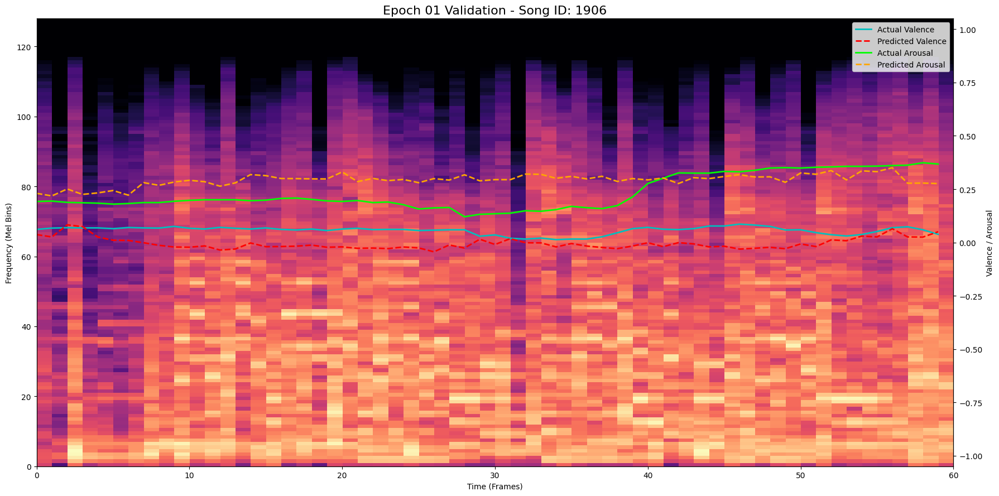

  → Validation loss decreased (inf --> 0.0572). Saving model...
Epoch 02 | Train Loss: 0.0495 | Val Loss: 0.0447 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1706, R2(V/A): 0.1696/0.5243, CCC(V/A): 0.2962/0.6390


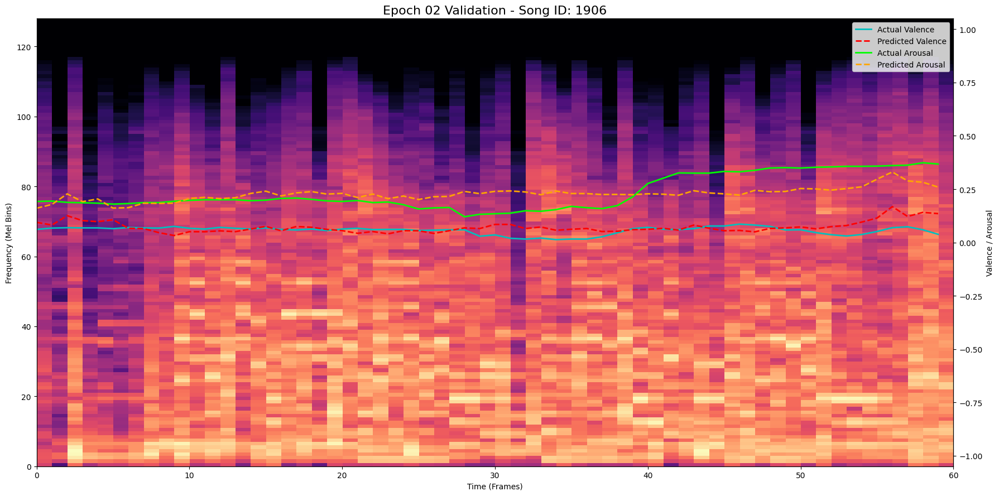

  → Validation loss decreased (0.0572 --> 0.0447). Saving model...
Epoch 03 | Train Loss: 0.0459 | Val Loss: 0.0509 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1761, R2(V/A): 0.1875/0.3573, CCC(V/A): 0.2388/0.5241


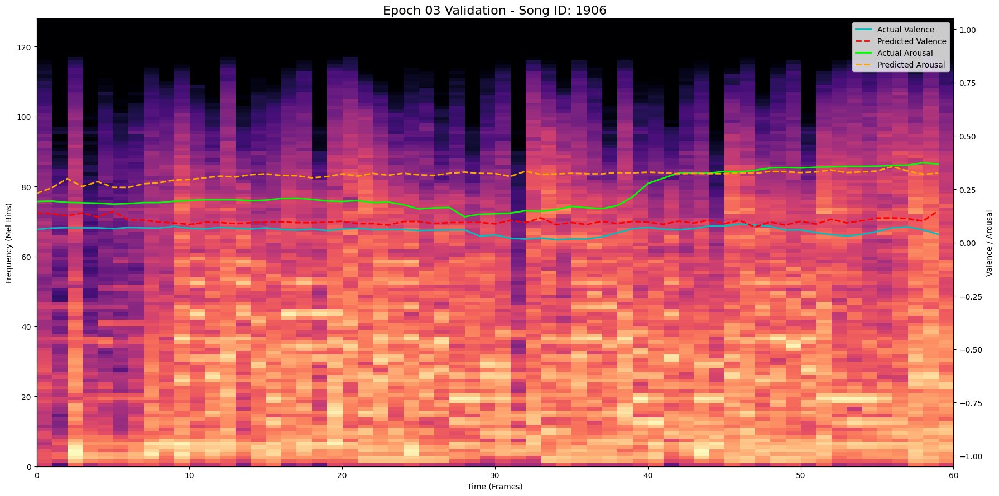

  → EarlyStopping counter: 1 out of 10
Epoch 04 | Train Loss: 0.0441 | Val Loss: 0.0451 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1690, R2(V/A): 0.1364/0.5378, CCC(V/A): 0.1774/0.6630


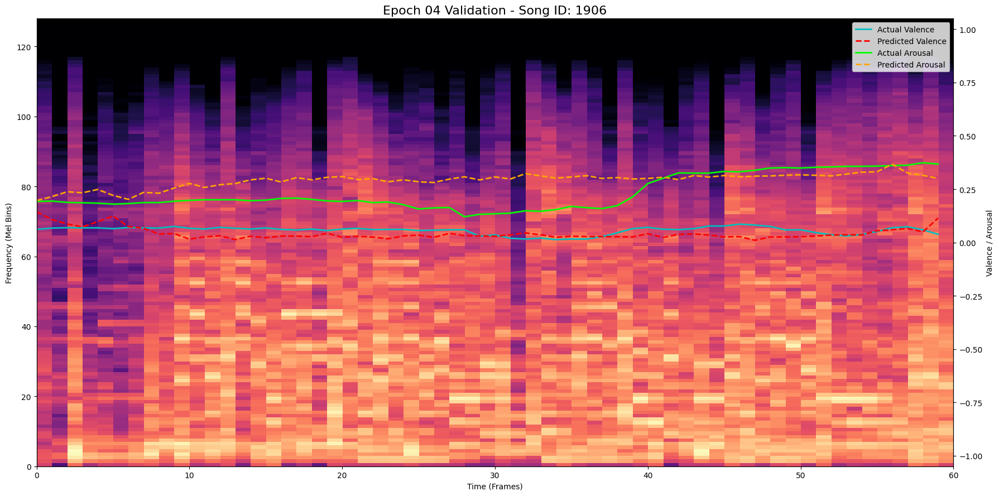

  → EarlyStopping counter: 2 out of 10
Epoch 05 | Train Loss: 0.0429 | Val Loss: 0.0411 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1574, R2(V/A): 0.2353/0.5629, CCC(V/A): 0.3647/0.7240


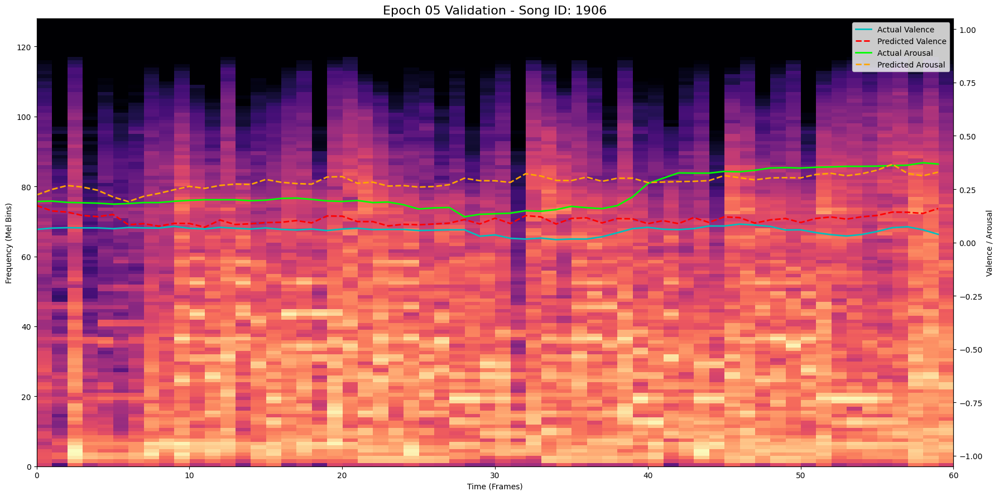

  → Validation loss decreased (0.0447 --> 0.0411). Saving model...
Epoch 06 | Train Loss: 0.0421 | Val Loss: 0.0618 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1884, R2(V/A): -0.1604/0.3501, CCC(V/A): 0.3427/0.6614


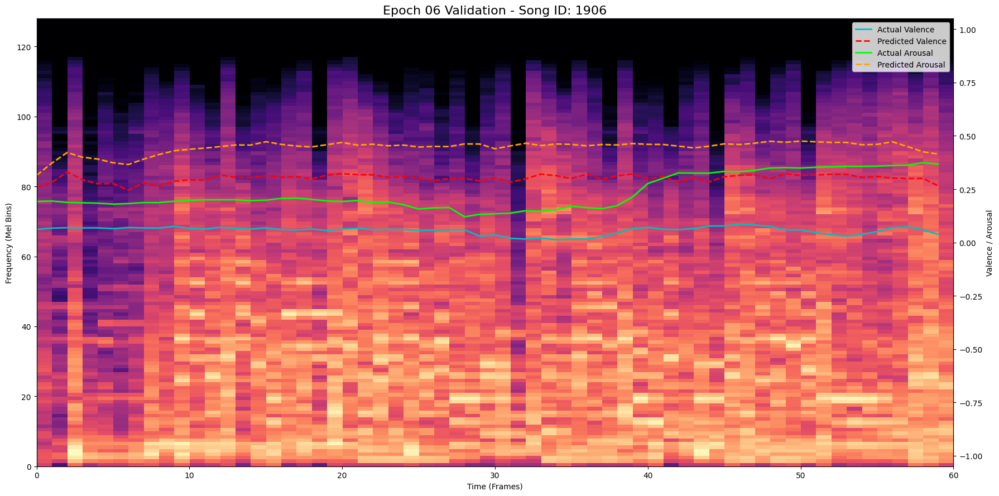

  → EarlyStopping counter: 1 out of 10
Epoch 07 | Train Loss: 0.0425 | Val Loss: 0.0455 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1709, R2(V/A): 0.0825/0.5681, CCC(V/A): 0.3636/0.7392


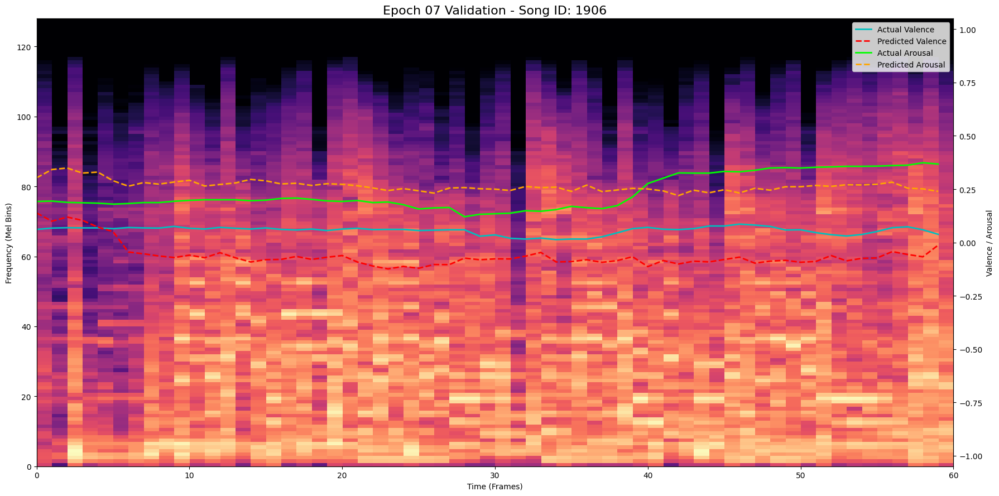

  → EarlyStopping counter: 2 out of 10
Epoch 08 | Train Loss: 0.0404 | Val Loss: 0.0399 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1571, R2(V/A): 0.3125/0.5347, CCC(V/A): 0.4733/0.6844


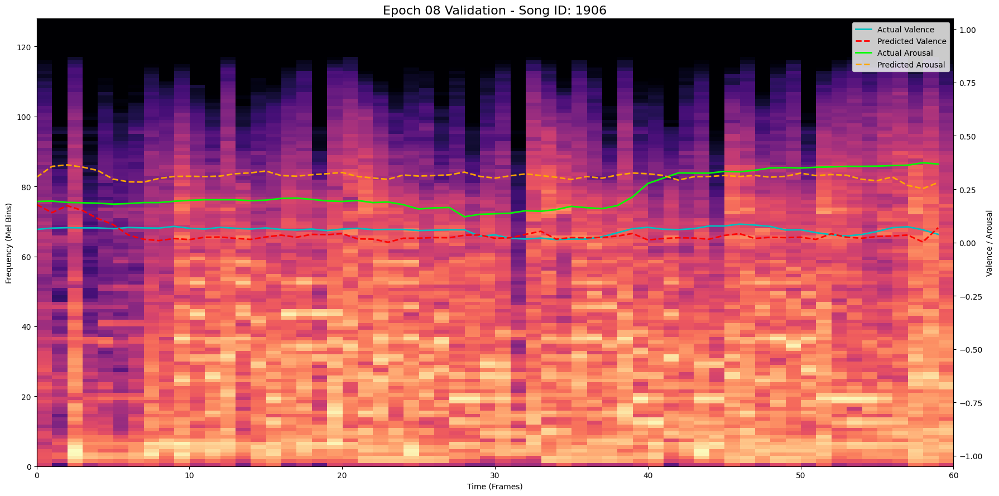

  → Validation loss decreased (0.0411 --> 0.0399). Saving model...
Epoch 09 | Train Loss: 0.0400 | Val Loss: 0.0547 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1824, R2(V/A): 0.2133/0.2442, CCC(V/A): 0.3909/0.5812


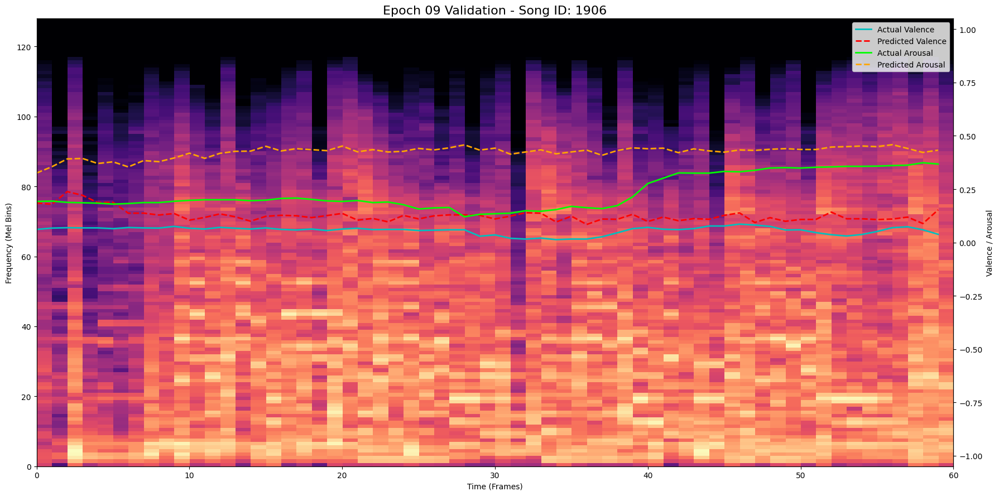

  → EarlyStopping counter: 1 out of 10
Epoch 10 | Train Loss: 0.0409 | Val Loss: 0.0529 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1759, R2(V/A): 0.0303/0.4273, CCC(V/A): 0.3301/0.6521


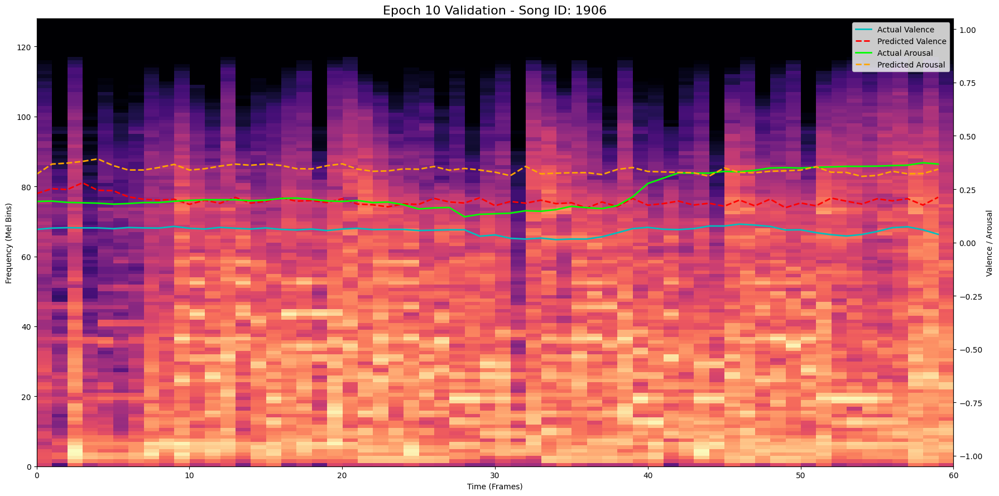

  → EarlyStopping counter: 2 out of 10
Epoch 11 | Train Loss: 0.0386 | Val Loss: 0.0493 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1717, R2(V/A): 0.1310/0.4398, CCC(V/A): 0.5092/0.7202


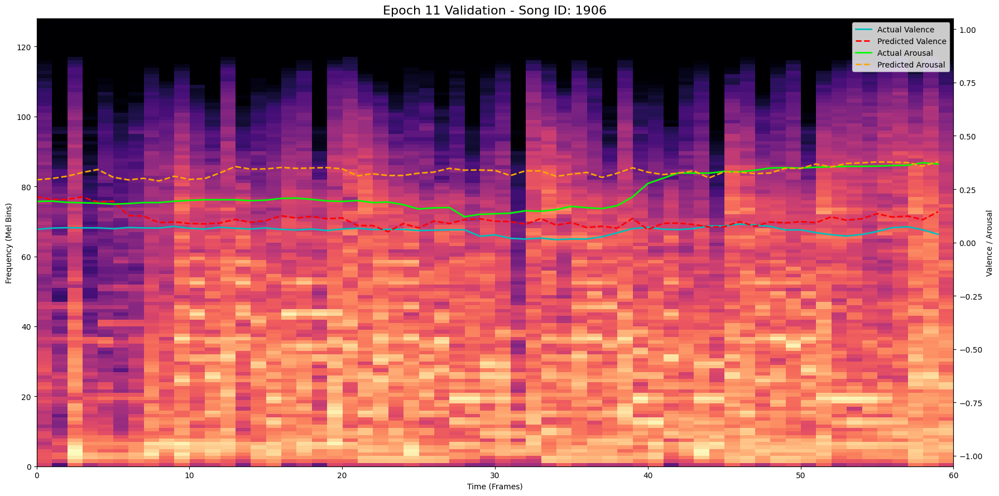

  → EarlyStopping counter: 3 out of 10
Epoch 12 | Train Loss: 0.0379 | Val Loss: 0.0386 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1536, R2(V/A): 0.2589/0.6060, CCC(V/A): 0.4792/0.7908


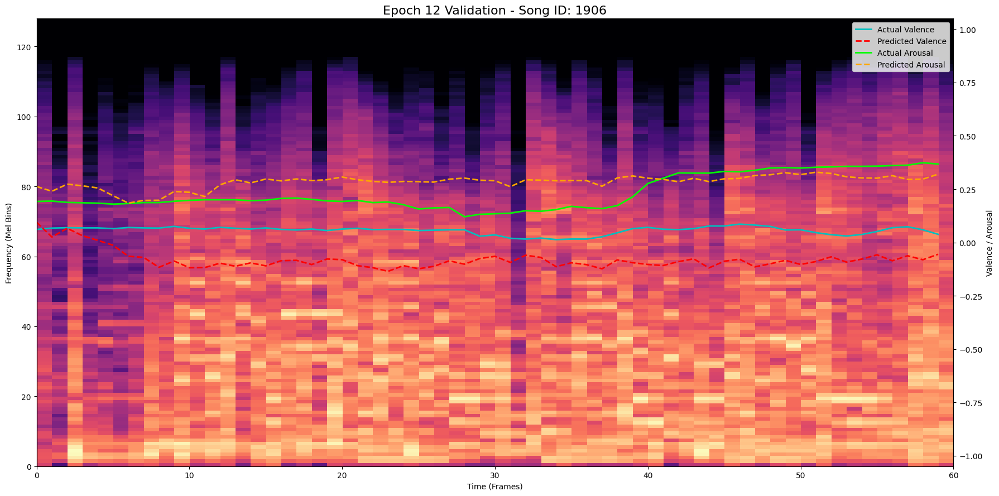

  → Validation loss decreased (0.0399 --> 0.0386). Saving model...
Epoch 13 | Train Loss: 0.0370 | Val Loss: 0.0400 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1547, R2(V/A): 0.2988/0.5430, CCC(V/A): 0.4641/0.7353


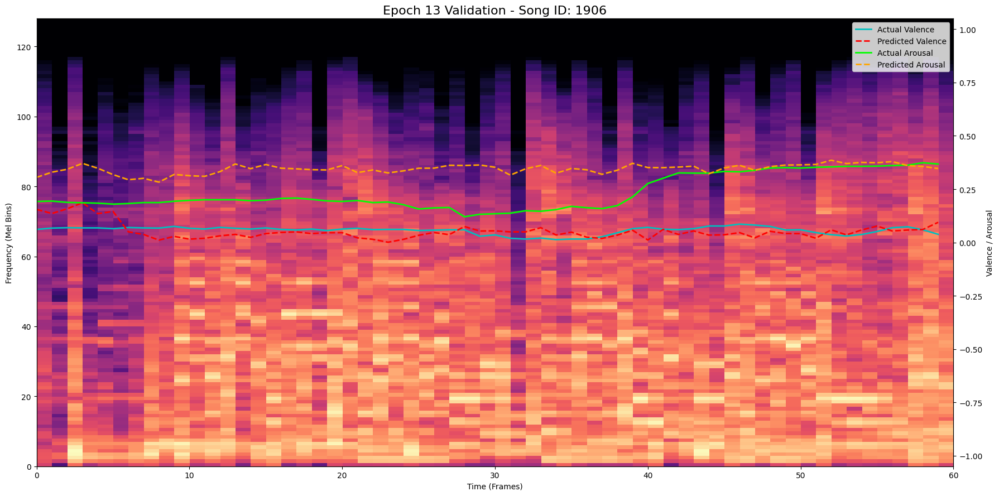

  → EarlyStopping counter: 1 out of 10
Epoch 14 | Train Loss: 0.0359 | Val Loss: 0.0533 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1834, R2(V/A): 0.2414/0.2596, CCC(V/A): 0.4175/0.6662


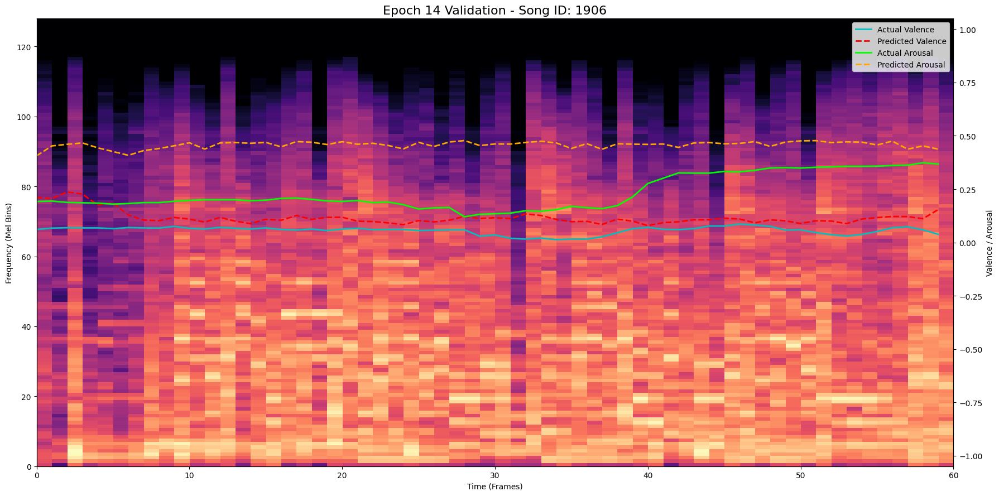

  → EarlyStopping counter: 2 out of 10
Epoch 15 | Train Loss: 0.0363 | Val Loss: 0.0483 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1709, R2(V/A): 0.1179/0.4740, CCC(V/A): 0.4393/0.7390


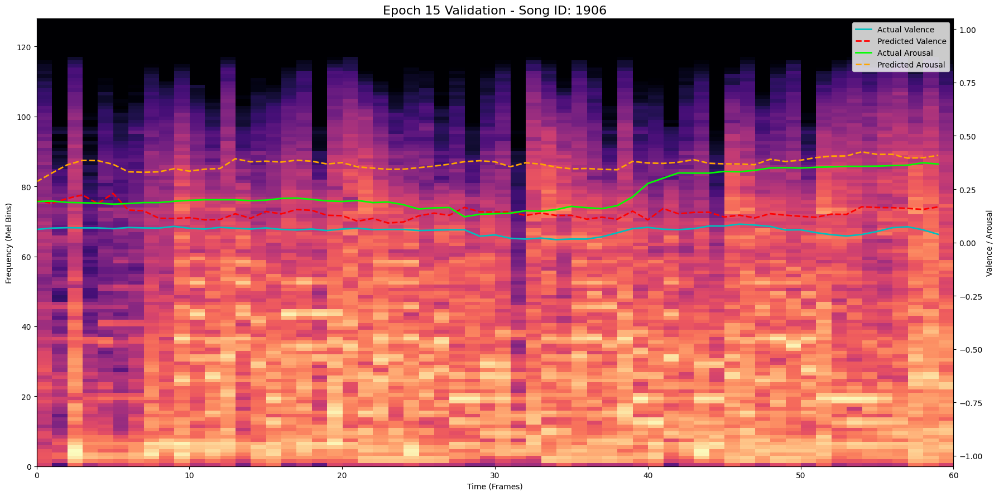

  → EarlyStopping counter: 3 out of 10
Epoch 16 | Train Loss: 0.0364 | Val Loss: 0.0365 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1492, R2(V/A): 0.3445/0.5945, CCC(V/A): 0.5172/0.7517


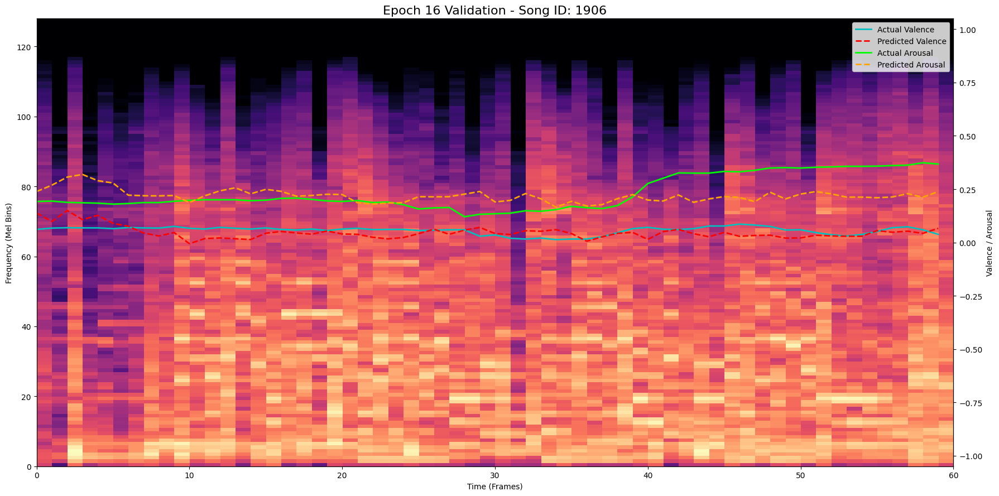

  → Validation loss decreased (0.0386 --> 0.0365). Saving model...
Epoch 17 | Train Loss: 0.0357 | Val Loss: 0.0438 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1605, R2(V/A): 0.1300/0.5762, CCC(V/A): 0.4965/0.7633


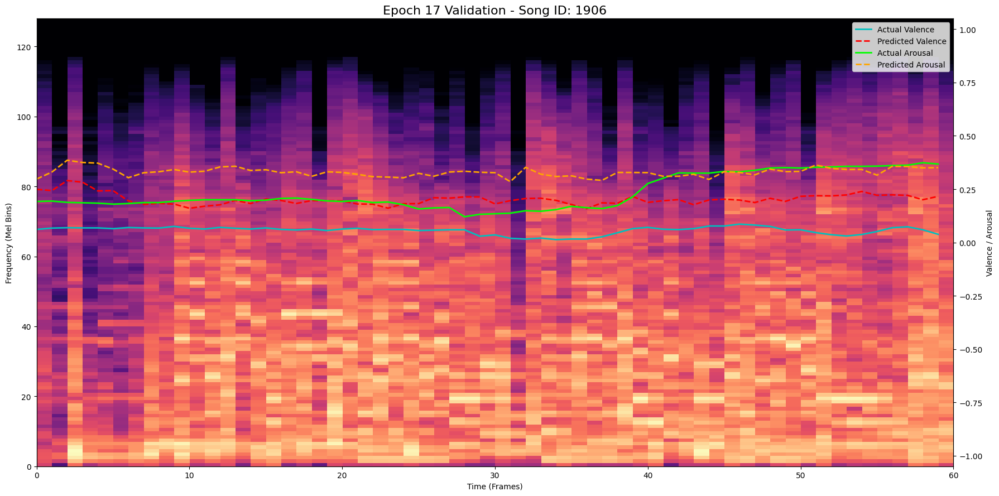

  → EarlyStopping counter: 1 out of 10
Epoch 18 | Train Loss: 0.0359 | Val Loss: 0.0604 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1920, R2(V/A): -0.0933/0.3358, CCC(V/A): 0.4320/0.6910


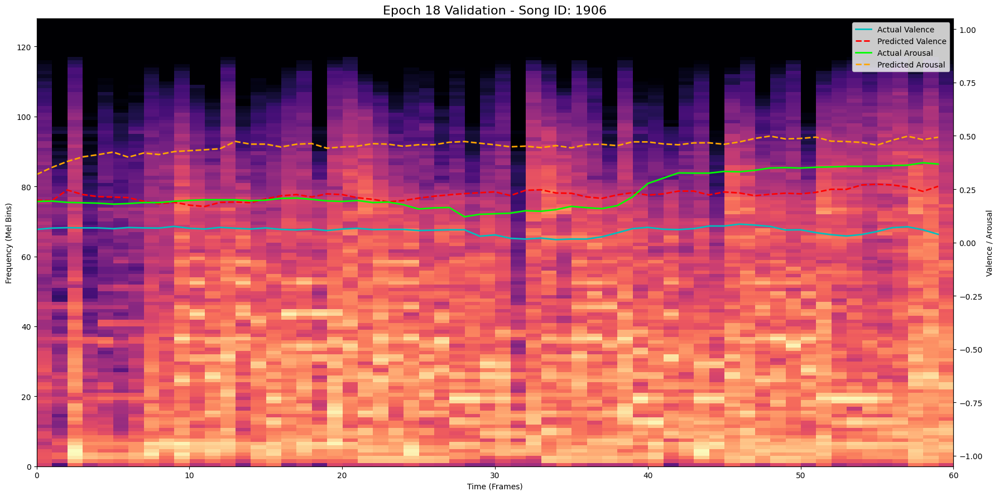

  → EarlyStopping counter: 2 out of 10
Epoch 19 | Train Loss: 0.0346 | Val Loss: 0.0705 | LR: 1.00e-04
  → Val Metrics: MAE: 0.2061, R2(V/A): -0.3201/0.2568, CCC(V/A): 0.2378/0.5891


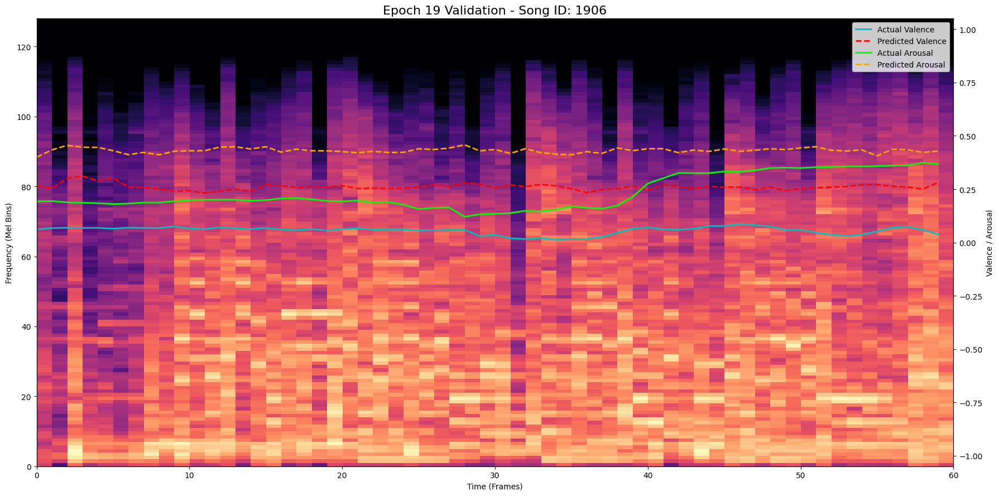

  → EarlyStopping counter: 3 out of 10
Epoch 20 | Train Loss: 0.0340 | Val Loss: 0.0367 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1477, R2(V/A): 0.3558/0.5803, CCC(V/A): 0.5633/0.7770


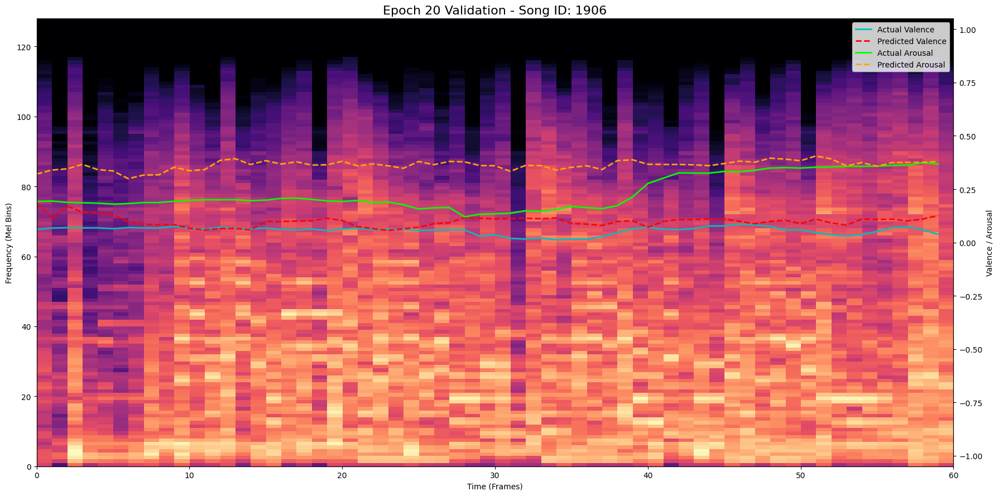

  → EarlyStopping counter: 4 out of 10
Epoch 21 | Train Loss: 0.0339 | Val Loss: 0.0486 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1713, R2(V/A): 0.2311/0.3814, CCC(V/A): 0.4867/0.6646


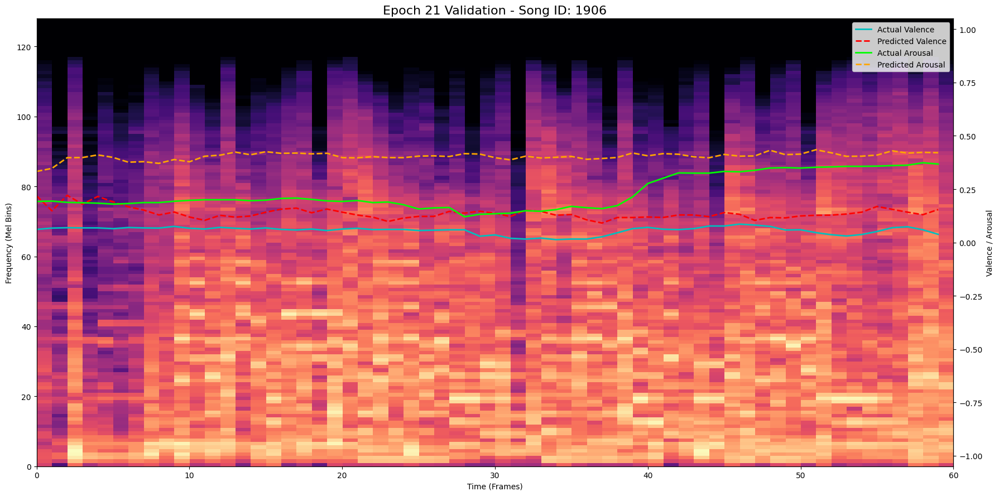

  → EarlyStopping counter: 5 out of 10
Epoch 22 | Train Loss: 0.0337 | Val Loss: 0.0351 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1427, R2(V/A): 0.3340/0.6357, CCC(V/A): 0.5067/0.8039


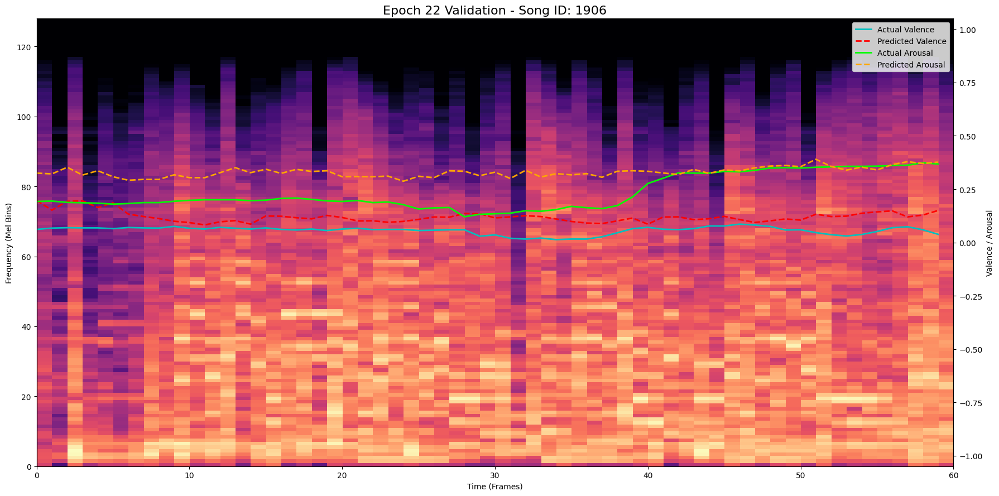

  → Validation loss decreased (0.0365 --> 0.0351). Saving model...
Epoch 23 | Train Loss: 0.0329 | Val Loss: 0.0343 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1417, R2(V/A): 0.3570/0.6396, CCC(V/A): 0.5479/0.8048


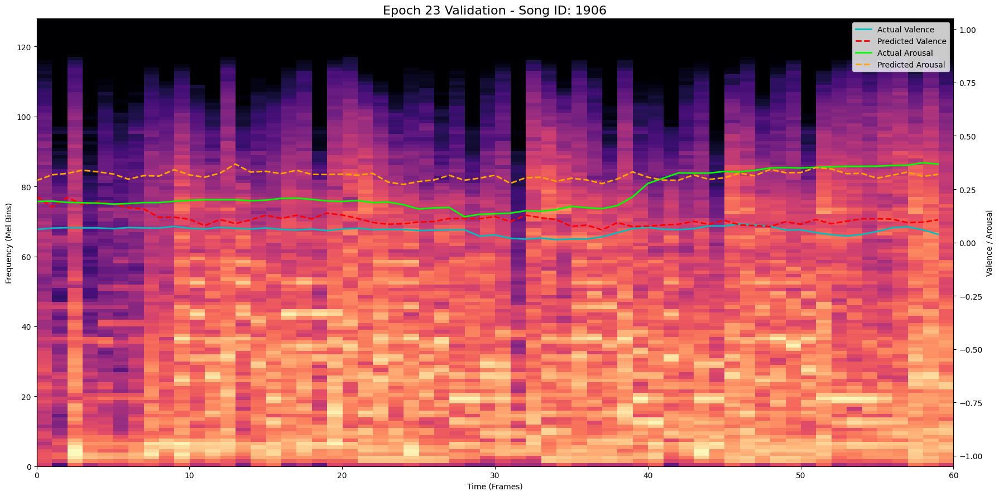

  → Validation loss decreased (0.0351 --> 0.0343). Saving model...
Epoch 24 | Train Loss: 0.0326 | Val Loss: 0.0453 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1671, R2(V/A): 0.3010/0.4101, CCC(V/A): 0.5480/0.7360


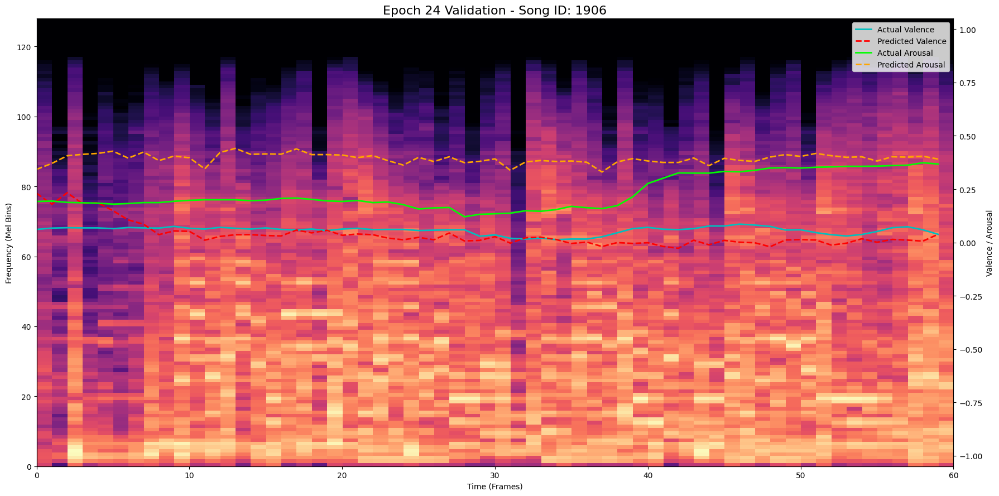

  → EarlyStopping counter: 1 out of 10
Epoch 25 | Train Loss: 0.0321 | Val Loss: 0.0537 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1821, R2(V/A): 0.2514/0.2400, CCC(V/A): 0.5519/0.6310


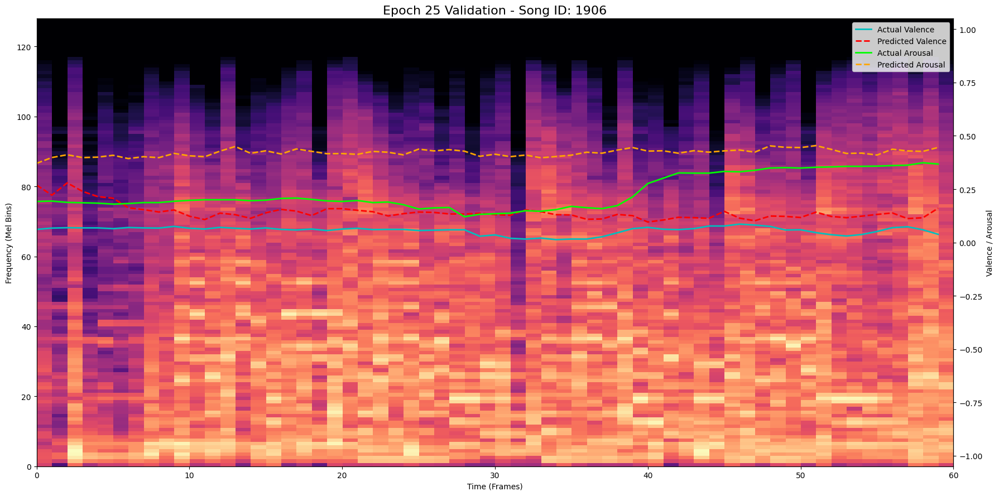

  → EarlyStopping counter: 2 out of 10
Epoch 26 | Train Loss: 0.0331 | Val Loss: 0.0539 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1813, R2(V/A): 0.0671/0.3742, CCC(V/A): 0.5079/0.7124


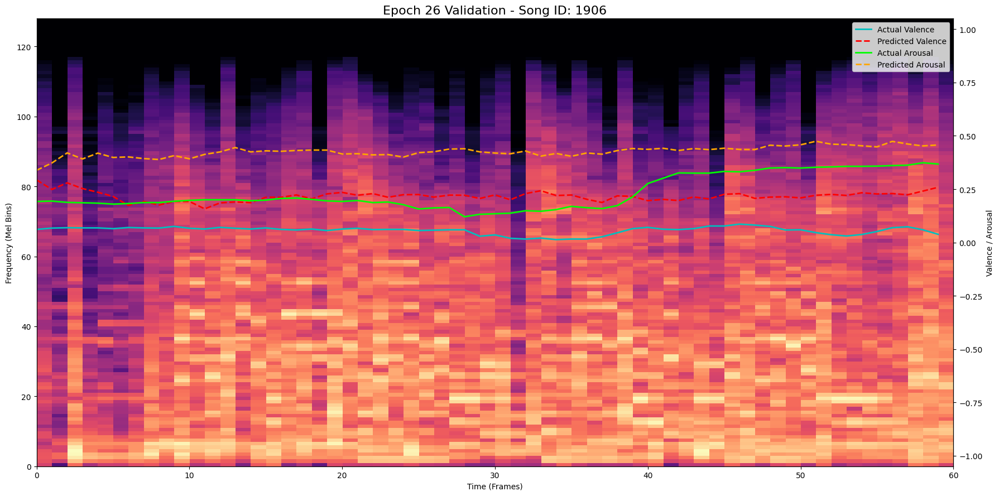

  → EarlyStopping counter: 3 out of 10
Epoch 27 | Train Loss: 0.0311 | Val Loss: 0.0456 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1657, R2(V/A): 0.2450/0.4457, CCC(V/A): 0.4856/0.7314


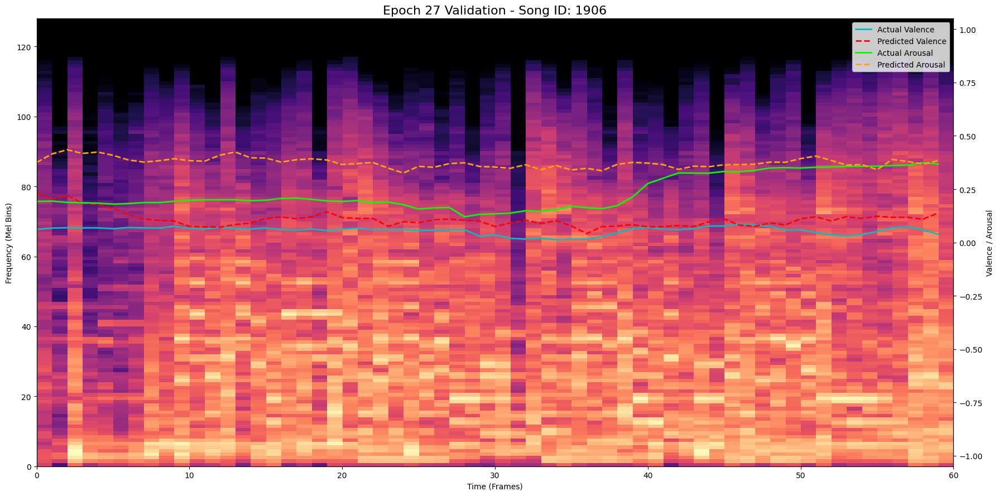

  → EarlyStopping counter: 4 out of 10
Epoch 28 | Train Loss: 0.0303 | Val Loss: 0.0540 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1822, R2(V/A): 0.1756/0.2893, CCC(V/A): 0.5142/0.6641


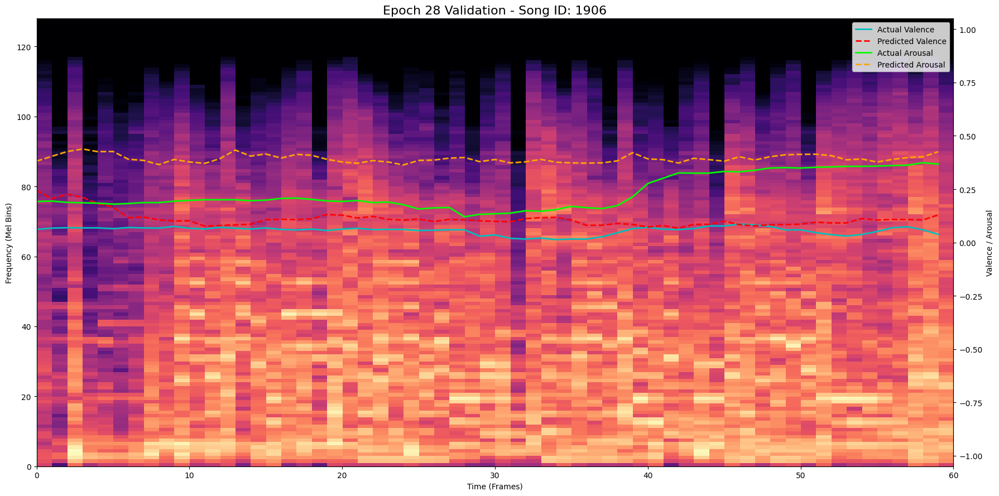

  → EarlyStopping counter: 5 out of 10
Epoch 29 | Train Loss: 0.0310 | Val Loss: 0.0520 | LR: 1.00e-04
  → Val Metrics: MAE: 0.1799, R2(V/A): 0.2290/0.3003, CCC(V/A): 0.5232/0.6344


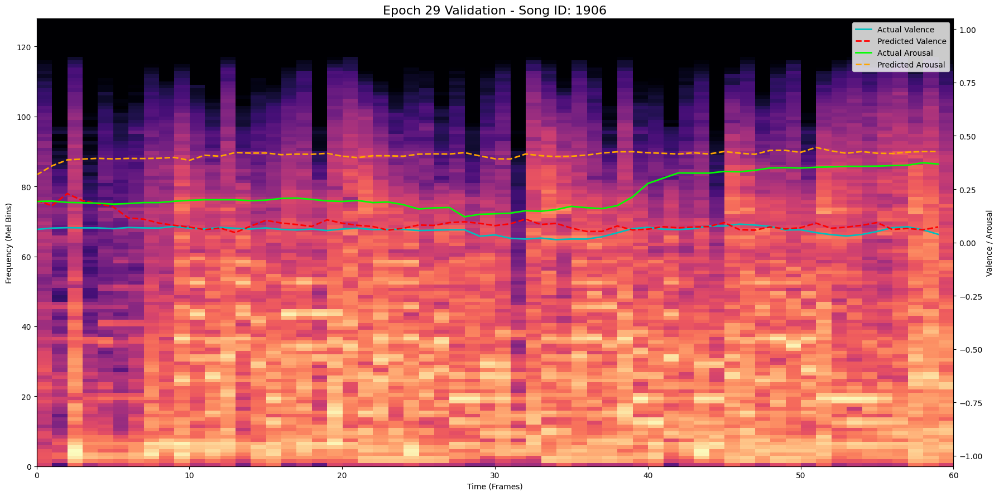

  → EarlyStopping counter: 6 out of 10
Epoch 30 | Train Loss: 0.0293 | Val Loss: 0.0428 | LR: 5.00e-05
  → Val Metrics: MAE: 0.1589, R2(V/A): 0.2801/0.4882, CCC(V/A): 0.5971/0.7369


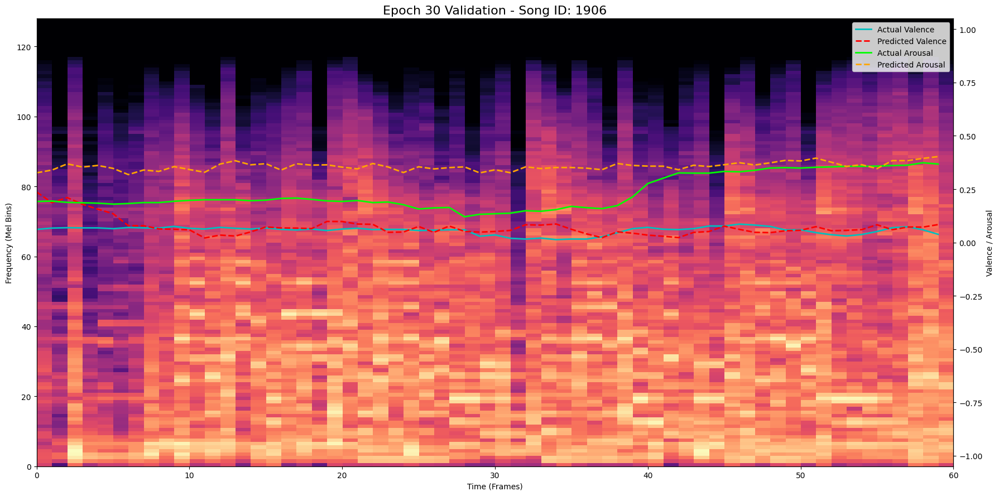

  → EarlyStopping counter: 7 out of 10
Epoch 31 | Train Loss: 0.0281 | Val Loss: 0.0474 | LR: 5.00e-05
  → Val Metrics: MAE: 0.1690, R2(V/A): 0.2790/0.3751, CCC(V/A): 0.6143/0.7173


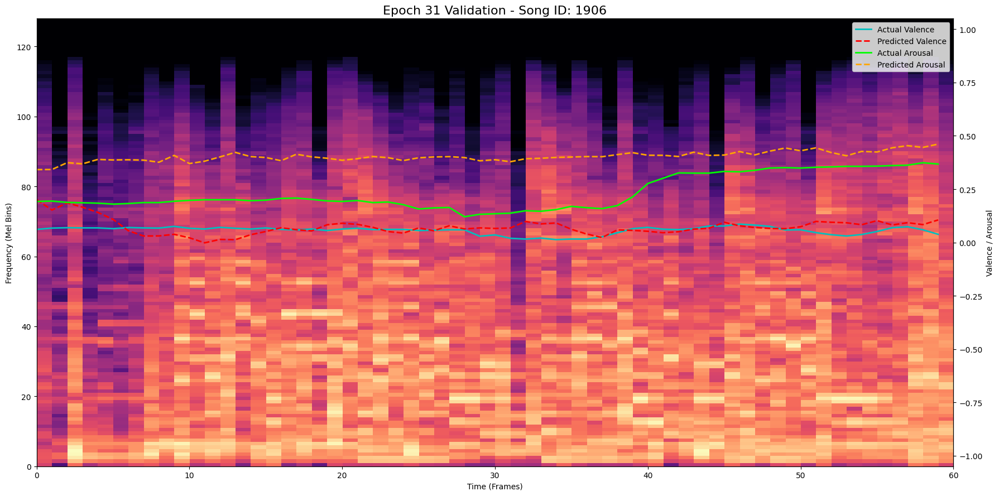

  → EarlyStopping counter: 8 out of 10
Epoch 32 | Train Loss: 0.0285 | Val Loss: 0.0471 | LR: 5.00e-05
  → Val Metrics: MAE: 0.1691, R2(V/A): 0.2850/0.3791, CCC(V/A): 0.5673/0.6918


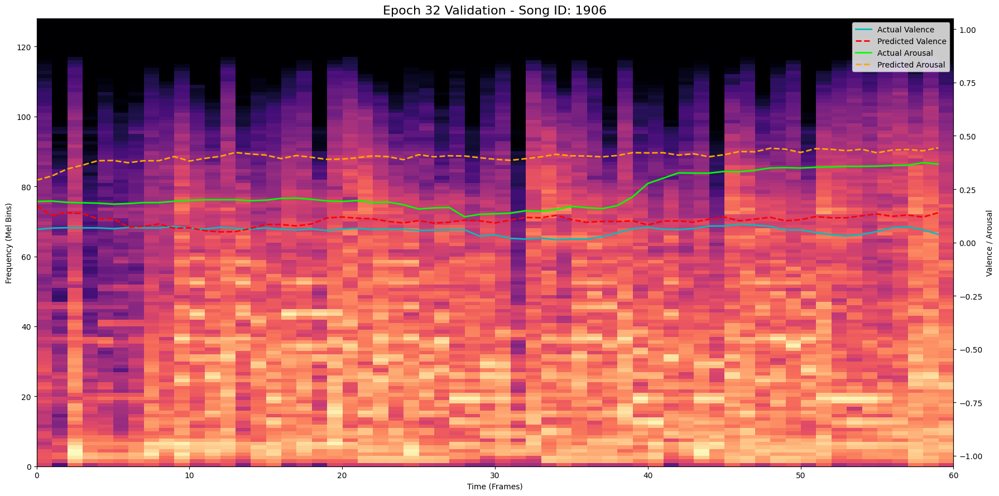

  → EarlyStopping counter: 9 out of 10
Epoch 33 | Train Loss: 0.0272 | Val Loss: 0.0498 | LR: 5.00e-05
  → Val Metrics: MAE: 0.1738, R2(V/A): 0.1540/0.4106, CCC(V/A): 0.4920/0.6837


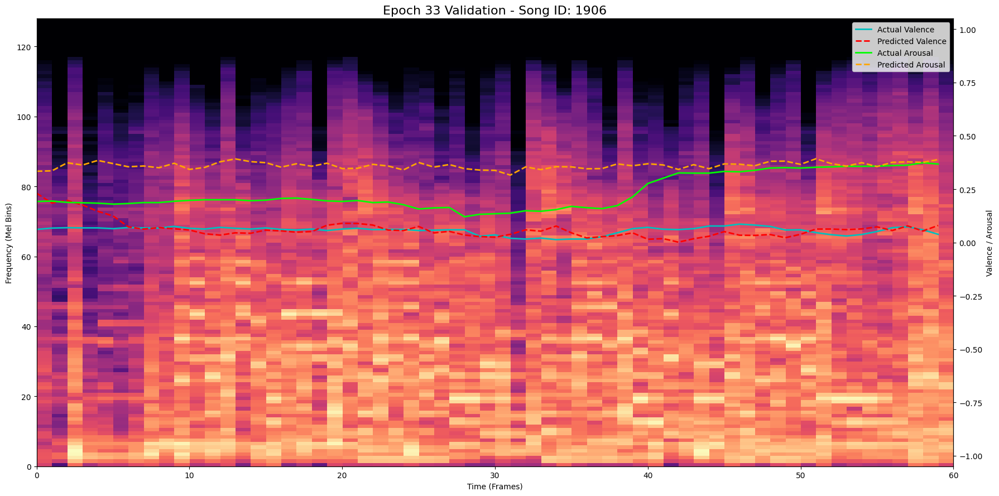

  → EarlyStopping counter: 10 out of 10

Early stopping at epoch 33. (Best Val Loss: 0.0343 @ epoch 23)

Training complete. Best model saved from epoch 23 with validation loss 0.0343.


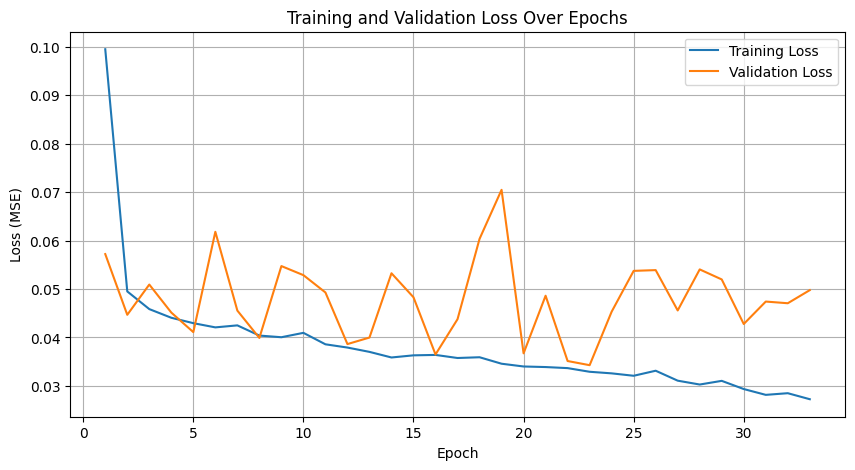


--- Starting Final Evaluation on Test Set ---


RuntimeError: CUDA error: CUBLAS_STATUS_INTERNAL_ERROR when calling cublasLtMatmul with transpose_mat1 0 transpose_mat2 0 m 512 n 572 k 128 mat1_ld 512 mat2_ld 128 result_ld 512 abcType 0 computeType 68 scaleType 0

In [ ]:
# -*- coding: utf-8 -*-
"""Audio_Model_v4_Overlay_Viz.ipynb

Automatically generated by Colab.

Original file is located at
    https://colab.research.google.com/drive/1...
"""

# ──────────────────────────────────────────────────────────────────────────────
# 0) 라이브러리 임포트
# ──────────────────────────────────────────────────────────────────────────────
# !pip install transformers -q # First-time setup: install transformers
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score
from transformers import GPT2Model, GPT2Config

# ──────────────────────────────────────────────────────────────────────────────
# 1) 데이터셋 로드 & 분할
# ──────────────────────────────────────────────────────────────────────────────
# Load the pre-processed dataset
raw = torch.load('DEAM_dataset_cleaned.pt')

# Extract data from the dictionary
clean_specs = raw['spectrograms']   # Tensor list or Tensor of shape (N,1,128,60)
clean_anns  = raw['annotations']    # Tensor list or Tensor of shape (N,60,2)
clean_ids   = raw['song_ids']       # list or Tensor of shape (N,)

# Build a unified list of dictionaries for easier handling
N = len(clean_ids)
data_list = []
for i in range(N):
    song_id = int(clean_ids[i])
    spec    = clean_specs[i]   # Tensor[1,128,60]
    ann     = clean_anns[i]    # Tensor[60,2]
    data_list.append({'song_id': song_id, 'spec': spec, 'ann': ann})

# ──────────────────────────────────────────────────────────────────────────────
# 2) Train/Val/Test 분할 (노래 ID 기준)
# ──────────────────────────────────────────────────────────────────────────────
train_val_ids = {d['song_id'] for d in data_list if d['song_id'] <= 2000}
test_ids      = {d['song_id'] for d in data_list if d['song_id']  > 2000}

class DEAMDataset(Dataset):
    def __init__(self, items, id_set):
        self.samples = [d for d in items if d['song_id'] in id_set]
    def __len__(self):
        return len(self.samples)
    def __getitem__(self, idx):
        # Return spectrogram, annotation, and song_id
        sample = self.samples[idx]
        return sample['spec'], sample['ann'], sample['song_id']

train_val_ds = DEAMDataset(data_list, train_val_ids)
test_ds      = DEAMDataset(data_list, test_ids)

# Reserve 10% of the training/validation set for validation
val_ratio = 0.1
val_size  = int(len(train_val_ds) * val_ratio)
train_size = len(train_val_ds) - val_size
train_ds, val_ds = random_split(
    train_val_ds,
    [train_size, val_size],
    generator=torch.Generator().manual_seed(42)
)

# ──────────────────────────────────────────────────────────────────────────────
# 3) DataLoader 설정
# ──────────────────────────────────────────────────────────────────────────────
batch_size  = 16
num_workers = 2 # 4 may cause warnings/errors in some environments

train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True,  num_workers=num_workers)
val_loader   = DataLoader(val_ds,   batch_size=batch_size, shuffle=False, num_workers=num_workers) # No need to shuffle validation
test_loader  = DataLoader(test_ds,  batch_size=1,          shuffle=False, num_workers=num_workers)

# ──────────────────────────────────────────────────────────────────────────────
# 4) 모델 정의 (CNNTransformer)
# ──────────────────────────────────────────────────────────────────────────────
class CNNTransformer(nn.Module):
    def __init__(self, dropout_cfg=(0.2, 0.2, 0.3, 0.3), negative_slope=0.5,
                 n_layers=4, n_heads=4, trans_dropout=0.2):
        super().__init__()

        # --- CNN Backbone ---
        d1, d2, d3, d4 = dropout_cfg
        nl = negative_slope
        self.cnn_backbone = nn.Sequential(
            # Block 1
            nn.Conv2d(1, 16, kernel_size=3, padding=1), nn.BatchNorm2d(16),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Conv2d(16, 16, kernel_size=3, padding=1), nn.BatchNorm2d(16),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Dropout(d1), nn.MaxPool2d((2, 1), stride=(2, 1)),
            # Block 2
            nn.Conv2d(16, 32, kernel_size=3, padding=1), nn.BatchNorm2d(32),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Conv2d(32, 32, kernel_size=3, padding=1), nn.BatchNorm2d(32),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Dropout(d2), nn.MaxPool2d((2, 1), stride=(2, 1)),
            # Block 3
            nn.Conv2d(32, 64, kernel_size=3, padding=1), nn.BatchNorm2d(64),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Conv2d(64, 64, kernel_size=3, padding=1), nn.BatchNorm2d(64),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Dropout(d3), nn.MaxPool2d((2, 1), stride=(2, 1)),
            # Block 4
            nn.Conv2d(64, 128, kernel_size=3, padding=1), nn.BatchNorm2d(128),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Conv2d(128, 128, kernel_size=3, padding=1), nn.BatchNorm2d(128),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.Dropout(d4), nn.MaxPool2d((2, 1), stride=(2, 1)),
            nn.Conv2d(128, 128, kernel_size=3, padding=1), nn.BatchNorm2d(128),
            nn.LeakyReLU(negative_slope=nl, inplace=True),
            nn.MaxPool2d((8, 1), stride=(8, 1)),
        )

        # --- Transformer Decoder ---
        config = GPT2Config(
            vocab_size=1, n_positions=60, n_embd=128,
            n_layer=n_layers, n_head=n_heads,
            resid_pdrop=trans_dropout, attn_pdrop=trans_dropout,
        )
        self.transformer = GPT2Model(config)

        # --- Prediction Head ---
        self.prediction_head = nn.Linear(128, 2)

    def forward(self, x):
        x = self.cnn_backbone(x)
        x = x.squeeze(2).permute(0, 2, 1)
        transformer_outputs = self.transformer(inputs_embeds=x)
        hidden_states = transformer_outputs.last_hidden_state
        predictions = self.prediction_head(hidden_states)
        return torch.tanh(predictions)


# ──────────────────────────────────────────────────────────────────────────────
# 5) 시각화 헬퍼 함수 및 지표 정의
# ──────────────────────────────────────────────────────────────────────────────
def plot_predictions(spec, actual, pred, title=""):
    """
    Generates a plot with the spectrogram as a background and overlays
    the actual and predicted valence/arousal graphs.
    """
    # Prepare data for plotting
    spec_np = spec.squeeze(0).cpu().numpy()
    actual_np = actual.detach().cpu().numpy()
    pred_np = pred.detach().cpu().numpy()

    fig, ax = plt.subplots(figsize=(18, 9))

    # --- Plot Spectrogram Background ---
    # extent: x-axis from 0 to 60 (time), y-axis from 0 to 128 (mel bins)
    ax.imshow(spec_np, origin='lower', cmap='magma', aspect='auto', extent=[0, 60, 0, 128])
    ax.set_ylabel("Frequency (Mel Bins)")
    ax.set_xlabel("Time (Frames)")
    ax.set_ylim(0, 128) # Fix y-axis to mel bin range

    # --- Create a second y-axis for Valence/Arousal ---
    ax_right = ax.twinx()
    ax_right.set_ylim(-1.05, 1.05)
    ax_right.set_ylabel("Valence / Arousal")

    # --- Rescale and Plot Valence/Arousal on the main axis ---
    # We rescale the V/A values from [-1, 1] to a visible range on the spectrogram's Y-axis [0, 128]
    # Let's map it to the [10, 118] range so it doesn't touch the edges.
    Y_MIN, Y_MAX = 10, 118
    rescale = lambda y: (y + 1) / 2 * (Y_MAX - Y_MIN) + Y_MIN

    time_steps = np.arange(actual_np.shape[0])

    ax.plot(time_steps, rescale(actual_np[:, 0]), 'c-', linewidth=2, label='Actual Valence')
    ax.plot(time_steps, rescale(pred_np[:, 0]), 'r--', linewidth=2, label='Predicted Valence')
    ax.plot(time_steps, rescale(actual_np[:, 1]), color='lime', linestyle='-', linewidth=2, label='Actual Arousal')
    ax.plot(time_steps, rescale(pred_np[:, 1]), color='orange', linestyle='--', linewidth=2, label='Predicted Arousal')

    # --- Final Touches ---
    ax.set_title(title, fontsize=16)
    ax.legend(loc='upper right')
    fig.tight_layout()
    plt.show()


def concordance_correlation_coefficient(y_true, y_pred):
    """Calculates the Concordance Correlation Coefficient."""
    true_mean, pred_mean = np.mean(y_true), np.mean(y_pred)
    true_var, pred_var = np.var(y_true), np.var(y_pred)
    covariance = np.mean((y_true - true_mean) * (y_pred - pred_mean))
    ccc = (2 * covariance) / (true_var + pred_var + (true_mean - pred_mean)**2 + 1e-8)
    return ccc

# ──────────────────────────────────────────────────────────────────────────────
# 6) 학습 설정
# ──────────────────────────────────────────────────────────────────────────────
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = CNNTransformer().to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
criterion = nn.MSELoss()
scheduler = optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, mode='min', factor=0.5, patience=5, verbose=True
)

num_epochs = 50
best_val_loss = float('inf')
early_stop_patience = 10
early_stop_counter = 0

# History tracking
train_loss_history = []
val_loss_history = []

print(f"Using device: {device}")
total_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f"Model has {total_params:,} trainable parameters.")


# ──────────────────────────────────────────────────────────────────────────────
# 7) 학습 루프 (Train / Validation / Scheduler / Checkpoint / Visualization)
# ──────────────────────────────────────────────────────────────────────────────
for epoch in range(1, num_epochs + 1):
    # --- TRAIN ---
    model.train()
    running_train_loss = 0.0
    for spec, ann, _ in train_loader:
        spec, ann = spec.to(device), ann.to(device)
        optimizer.zero_grad()
        pred = model(spec)
        loss = criterion(pred, ann)
        loss.backward()
        optimizer.step()
        running_train_loss += loss.item() * spec.size(0)
    train_loss = running_train_loss / len(train_loader.dataset.indices)
    train_loss_history.append(train_loss)

    # --- VALIDATION ---
    model.eval()
    running_val_loss = 0.0
    all_preds, all_trues = [], []
    last_val_batch = {} # For visualization

    with torch.no_grad():
        for i, (spec, ann, ids) in enumerate(val_loader):
            spec, ann = spec.to(device), ann.to(device)
            pred = model(spec)
            running_val_loss += criterion(pred, ann).item() * spec.size(0)

            all_preds.append(pred.cpu().numpy().reshape(-1, 2))
            all_trues.append(ann.cpu().numpy().reshape(-1, 2))

            # Store the first batch for end-of-epoch visualization
            if i == 0:
                last_val_batch['spec'] = spec[0]  # <-- Store spectrogram
                last_val_batch['ann'] = ann[0]
                last_val_batch['pred'] = pred[0]
                last_val_batch['id'] = ids[0]

    val_loss = running_val_loss / len(val_loader.dataset.indices)
    val_loss_history.append(val_loss)

    preds_np = np.vstack(all_preds)
    trues_np = np.vstack(all_trues)

    # --- Calculate Metrics ---
    mae = np.mean(np.abs(preds_np - trues_np))
    r2_val = r2_score(trues_np[:, 0], preds_np[:, 0])
    r2_aro = r2_score(trues_np[:, 1], preds_np[:, 1])
    ccc_val = concordance_correlation_coefficient(trues_np[:, 0], preds_np[:, 0])
    ccc_aro = concordance_correlation_coefficient(trues_np[:, 1], preds_np[:, 1])

    # --- Log & Visualize ---
    lr = optimizer.param_groups[0]['lr']
    print(f"Epoch {epoch:02d} | Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f} | LR: {lr:.2e}")
    print(f"  → Val Metrics: MAE: {mae:.4f}, R2(V/A): {r2_val:.4f}/{r2_aro:.4f}, CCC(V/A): {ccc_val:.4f}/{ccc_aro:.4f}")

    # Plot predictions for a sample from the validation set
    plot_title = f"Epoch {epoch:02d} Validation - Song ID: {last_val_batch['id']}"
    # Pass spectrogram to the plotting function
    plot_predictions(last_val_batch['spec'], last_val_batch['ann'], last_val_batch['pred'], title=plot_title)

    # --- Scheduler, Checkpoint & EarlyStopping ---
    scheduler.step(val_loss)
    if val_loss < best_val_loss:
        print(f"  → Validation loss decreased ({best_val_loss:.4f} --> {val_loss:.4f}). Saving model...")
        best_val_loss = val_loss
        torch.save(model.state_dict(), 'best_emotion_cnn_transformer.pt')
        early_stop_counter = 0
        best_epoch = epoch
    else:
        early_stop_counter += 1
        print(f"  → EarlyStopping counter: {early_stop_counter} out of {early_stop_patience}")

    if early_stop_counter >= early_stop_patience:
        print(f"\nEarly stopping at epoch {epoch}. (Best Val Loss: {best_val_loss:.4f} @ epoch {best_epoch})")
        break

print(f"\nTraining complete. Best model saved from epoch {best_epoch} with validation loss {best_val_loss:.4f}.")

# ──────────────────────────────────────────────────────────────────────────────
# 8) 학습 과정 시각화 (Loss Curve)
# ──────────────────────────────────────────────────────────────────────────────
plt.figure(figsize=(10, 5))
plt.plot(range(1, len(train_loss_history) + 1), train_loss_history, label='Training Loss')
plt.plot(range(1, len(val_loss_history) + 1), val_loss_history, label='Validation Loss')
plt.title('Training and Validation Loss Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss (MSE)')
plt.legend()
plt.grid(True)
plt.show()

# ──────────────────────────────────────────────────────────────────────────────
# 9) 테스트 및 최종 평가
# ──────────────────────────────────────────────────────────────────────────────
print("\n--- Starting Final Evaluation on Test Set ---")
# Load the best performing model
model.load_state_dict(torch.load('best_emotion_cnn_transformer.pt'))
model.to(device)
model.eval()

test_loss = 0.0
all_test_preds, all_test_trues = [], []

with torch.no_grad():
    for spec, ann, song_id in test_loader:
        spec, ann = spec.to(device), ann.to(device)
        pred = model(spec)

        # Squeeze batch dimension for single-item batch
        spec_sq, ann_sq, pred_sq = spec.squeeze(0), ann.squeeze(0), pred.squeeze(0)
        song_id_item = song_id.item()

        # Accumulate loss
        loss = criterion(pred, ann)
        test_loss += loss.item()

        # Store predictions and true values for aggregate metrics
        all_test_preds.append(pred_sq.cpu().numpy())
        all_test_trues.append(ann_sq.cpu().numpy())

        # Visualize the prediction for this test song
        plot_title = f"Prediction vs. Actual for Test Song ID: {song_id_item}"
        # Pass spectrogram to the plotting function
        plot_predictions(spec_sq, ann_sq, pred_sq, title=plot_title)

# --- Calculate and Print Final Test Metrics ---
final_test_loss = test_loss / len(test_loader)
test_preds_np = np.vstack(all_test_preds)
test_trues_np = np.vstack(all_test_trues)

test_mae = np.mean(np.abs(test_preds_np - test_trues_np))
test_r2_val = r2_score(test_trues_np[:, 0], test_preds_np[:, 0])
test_r2_aro = r2_score(test_trues_np[:, 1], test_preds_np[:, 1])
test_ccc_val = concordance_correlation_coefficient(test_trues_np[:, 0], test_preds_np[:, 0])
test_ccc_aro = concordance_correlation_coefficient(test_trues_np[:, 1], test_preds_np[:, 1])

print("\n--- Final Test Set Performance ---")
print(f"Average Test MSE Loss: {final_test_loss:.4f}")
print(f"Test MAE: {test_mae:.4f}")
print(f"Test R² (Valence/Arousal): {test_r2_val:.4f} / {test_r2_aro:.4f}")
print(f"Test CCC (Valence/Arousal): {test_ccc_val:.4f} / {test_ccc_aro:.4f}")
print("--- Evaluation Complete ---")

In [ ]:
!pip install --upgrade torch transformers

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 821.2/821.2 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 393.1/393.1 MB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.9/8.9 MB 123.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 99.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 897.7/897.7 kB 57.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 571.0/571.0 MB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.2/200.2 MB 11.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 71.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 39.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.2/158.2 MB 14.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 216.6/216.6 MB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 156.8/156.8 MB 14.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━